## Data Mining Project DTSA 5506

### Background and Motivation
After completing a course on Deep Learning for Natural Language Processing, I became interested in exploring multimodal language models, particularly those capable of integrating vision and text. Among the models I reviewed, PaliGemma stands out as it is publicly available along with pretrained checkpoints, detailed documentation **[Google AI](https://ai.google.dev/gemma/docs/paligemma)**, training configurations **[Google Research GitHub](https://github.com/google-research/big_vision/tree/main/big_vision/configs/proj/paligemma)**, and **[Hugging Face Documentation](https://github.com/huggingface/transformers/blob/d1b92369ca193da49f9f7ecd01b08ece45c2c9aa/src/transformers/models/paligemma/modeling_paligemma.py)** 

My primary motivation for choosing this project was to gain a deeper understanding of how `PaliGemma, a Vision Language Model (VLM)` works internally. To achieve this, I followed the implementation in **[Umar Jamil's GitHub repository](https://github.com/hkproj/pytorch-paligemma)**, which mirrors the original architecture closely, including maintaining identical class naming conventions and module structures to ensure compatibility with the pretrained weights for direct loading. As I studied the code, I added detailed notes to document my understanding. While inspecting the model after loading the pretrained weights, I discovered that some default values in the SiglipVisionConfig and the GemmaForCausalLM configurations (such as the number of transformer encoder layers, the number of attention head, etc) did not match the actual model architecture defined in the config.json. Although the Hugging Face pretrained weight loading mechanism overrides these mismatches automatically, I updated my config definitions to reflect the true values for consistency and clarity. Later, I used the model to perform a `cross-modal retrieval task`, where the goal is to retrieve relevant images given a query text. To further my understanding of the model’s behavior and the dataset it was evaluated on, I also clustered the image embeddings output by the model to explore patterns and `semantic groupings` within the `Flickr30k dataset`.

Additionally, I chose PaliGemma because its relatively lightweight footprint, about 5.45 GB of weights, makes it manageable within my GPU’s memory limits, allowing for local experimentation without resorting to cloud-based resources or model distillation.

### About PaliGemma
PaliGemma is a Transformer-based model that combines a Vision Transformer (ViT) backbone for image encoding with a Gemma-style autoregressive language model for text encoding and generation.

The model processes images by dividing them into patches, embedding these patches, and passing them through multiple Transformer layers to capture rich visual features. Simultaneously, textual inputs are tokenized and processed by the language model. Cross-attention layers enable the language model to attend to the visual features, allowing the model to align and integrate information across modalities.

Both the visual and textual representations are projected into a shared embedding space, facilitating tasks such as image captioning, visual question answering, optical character recognition (OCR), and object detection. By mapping images and text into a common latent space, PaliGemma can measure semantic similarity between modalities and generate coherent, context-aware text conditioned on visual inputs.

### Methodology
For this project, I propose using PaliGemma to explore the structure of joint image-text embeddings on the `Flickr30k` dataset, which contains 31,014 images paired with multiple human-annotated captions. The first step will be to evaluate the quality of these embeddings using a cross-modal retrieval task with visual evaluation. This retrieval task demonstrates the cross-modal capabilities of the PaliGemma model: given a text query, it retrieves the most relevant images (and vice versa) using cosine similarity in the shared embedding space. Since both modalities are encoded into a common vector space, this enables efficient similarity search across modalities. Visualizing the retrieval results offers a qualitative assessment of how well the model aligns visual and textual semantics, and serves as a practical measure of multimodal alignment.

Following this, I will use the same joint embeddings to perform unsupervised clustering on the image-text pairs. Specifically, I will extract the final-layer vision embeddings for images and the corresponding text embeddings for captions, and then cluster these representations jointly using Batch K-Means, a widely used unsupervised algorithm that partitions data into groups based on feature similarity in the embedding space. The implementation will initialize the model using the pretrained weights from Hugging Face’s official PaliGemma release, ensuring consistency with the original architecture and leveraging the benefits of large-scale pretraining. By operating in the shared embedding space, this approach allows semantically similar images and captions to cluster together, even when the relationship is non-trivial (e.g. visually distinct scenes described with similar language, or vice versa).

This experiment aims to assess two key questions: (1) whether PaliGemma’s multimodal embeddings capture sufficient semantic structure to produce meaningful clusters across image-text pairs, and (2) whether such clustering can reveal latent relationships or anomalies within the dataset, such as outlier captions, semantically ambiguous images, or emergent thematic groups. The inclusion of cross-modal retrieval enhances the evaluation by providing an interpretable, visual benchmark for semantic alignment. The overall results will offer insights into the utility of multimodal Transformers for unsupervised data mining tasks.

### PaliGemma
Original paper: [PaliGemma: A versatile 3B VLM for transfer](https://arxiv.org/pdf/2407.07726)

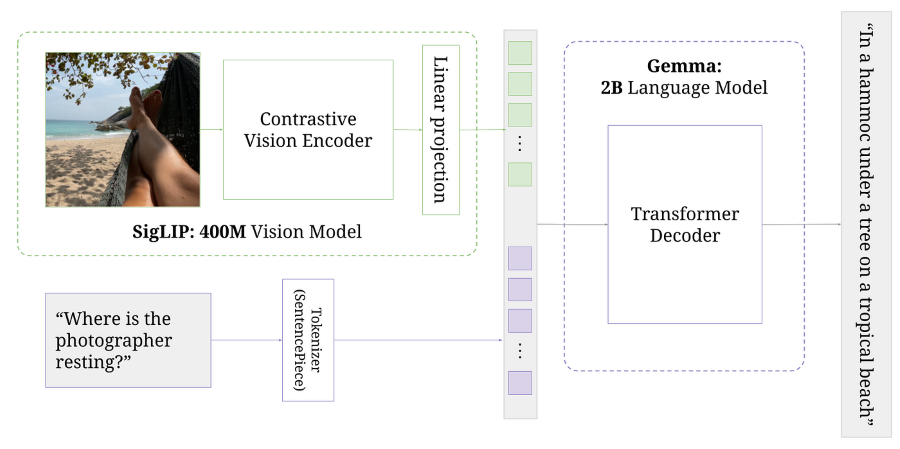

This diagram illustrates the architecture and data flow of PaliGemma, a vision-language model that combines SigLIP for visual understanding and Gemma for language generation. 

**Model pipeline:**

1. **Image Encoding with SigLIP**
   * Input: An image
   * Model: SigLIP (400M), a contrastive vision model designed to produce contextualized embeddings.
   * Process:
      * The image is passed through the Contrastive Vision Encoder, which:
         * Applies convolutional layers
         * Adds learnable positional encodings
          * Processes the result through multiple Transformer layers to contextualize the embeddings
      * The output is then passed through a linear projection layer, mapping the image representations (green blocks) into the shared embedding space used by language tokens.<br></br>
2. **Text Input Tokenization**
   * Input: A natural language query.
   * Tokenizer: The input prompt is tokenized using a SentencePiece tokenizer.
   * Output: A sequence of discrete text tokens (purple blocks) corresponding to the question. <br></br>
3. **Multimodal Fusion and Decoding with Gemma**
   * Model: Gemma (2B Language Model) - a transformer-based language model.
   * Architecture: Utilizes a Transformer Decoder that attends over both the:
      * Image embeddings (from SigLIP), and
      * Tokenized text prompt.
   * Fusion: The vision and language embeddings are concatenated and fed into the transformer decoder, enabling it to reason jointly over visual and textual information. <br></br>
4. **Output: Natural Language Generation**
   * The Transformer Decoder generates a natural language response conditioned on both the image and the question.

### Contrastive Vision Encoders: From CLIP to SigLIP
Learning joint representations of images and text has long been a challenge in multimodal AI. A breakthrough came with CLIP (Contrastive Language-Image Pre-training; Radford et al., 2021), which jointly trains a visual encoder and a text encoder to map images and their captions into a shared embedding space.

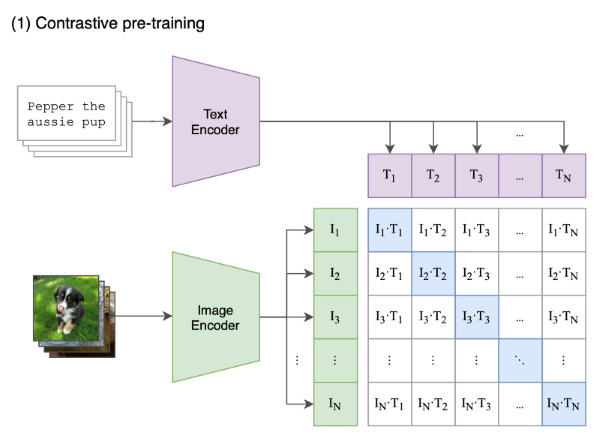

Given a batch of $N$ (image, text) pairs, CLIP computes the dense cosine similarity matrix between all $N \times N$ possible (image, text) candidates within this batch. The text and image encoders are jointly trained to maximize the similarity between $N$ correct pairs of (image, text) associations while minimizing the similarity for $N \times (N - 1)$ incorrect pairs via a symmetric cross entropy loss over the dense matrix.

The model is optimized using a contrastive objective: given a batch of $N$ (image, text) pairs, CLIP computes a dense cosine similarity matrix over all $N \times N$ possible image–text combinations within the batch. The encoders are trained to maximize similarity for the $N$ correct (image, text) pairs while minimizing similarity for the $N \times (N - 1)$ incorrect pairs via a symmetric cross-entropy loss applied to the similarity matrix. This training strategy encourages the model to align paired representations and separate unpaired ones, enabling zero-shot transfer to downstream tasks by directly comparing image and text embeddings.

This original CLIP training objective is computationally intensive due to the use of a symmetric cross-modal contrastive loss. Specifically, CLIP computes the InfoNCE (Information Noise Contrastive Estimation) loss across all image-text pairs in a batch, requiring separate softmax operations over both rows and columns of the similarity matrix. Because the similarity matrix (dot product between image and text embeddings) is not inherently symmetric and each axis must be normalized independently, this prevents efficient parallelization and increases memory and compute overhead.

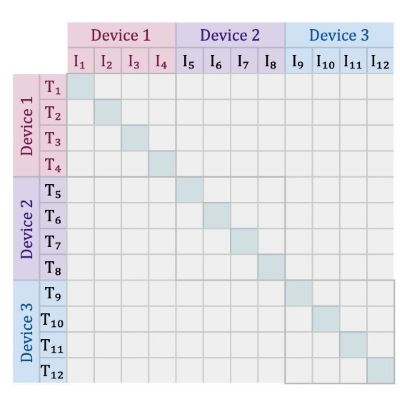

SigLIP addresses this inefficiency by replacing the softmax-based contrastive loss with a sigmoid-based binary cross-entropy loss applied to the similarity scores. This change eliminates the need for separate softmax normalization across both modalities and enables better scalability with respect to batch size and hardware utilization.

In the context of PaliGemma, integrating a contrastive vision encoder is beneficial because we want the image embeddings to serve a dual purpose: they should not only encode rich visual features but also be positioned in a shared embedding space where they can be meaningfully compared or contrasted with text embeddings. This alignment facilitates downstream tasks like image-text retrieval, vision-language reasoning, and instruction-following, where semantic correspondence between modalities is critical.

### Rotary Positional Embedding (RoPE)
PaliGemma uses Rotary Positional Embedding (RoPE), introduced in RoFormer (https://arxiv.org/abs/2104.09864).

Unlike traditional positional encodings that add a position-dependent vector to the input, RoPE applies a rotation to the query and key vectors in attention space. This position-dependent rotation allows the model to encode relative and absolute positions more naturally, enhancing its ability to model sequential relationships, especially in long contexts.

**Note**: In PaliGemma, RoPE is applied only in the language model, within the self-attention layers of the transformer decoder. The vision encoder (SigLIP) uses a different strategy: learnable positional embeddings via nn.Embedding for image patches.

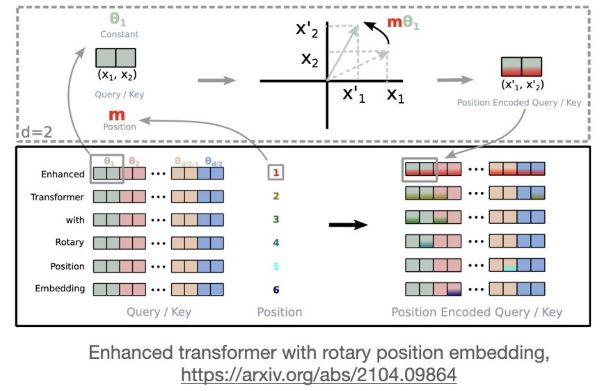

### RMSNorm
The Gemma language model, as released by Google, replaces standard LayerNorm with RMSNorm throughout its architecture. It is a simplified normalization layer that rescales input vectors by their root mean square, avoiding the need to subtract the mean or compute variance. It is shift-invariant, more efficient than LayerNorm, and requires only one learned parameter per feature (with no bias term). This is implemented via the GemmaRMSNorm module.

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import math
from PIL import Image
import json
import glob
from typing import Dict, List, Optional, Union, Tuple, Iterable
import torch
import torch.nn as nn
from torch.nn import CrossEntropyLoss
from datasets import load_dataset, Dataset
from torch.utils.data import DataLoader
from transformers import AutoTokenizer
from safetensors import safe_open
from tqdm import tqdm

#### SigLIP Vision Transformer Encoder
The input to the SigLIP encoder is a sequence of patch embeddings. These embeddings are produced by the SiglipVisionEmbeddings class, which splits each input image into non-overlapping patches, projects them to the desired embedding dimension using a convolutional layer, and augments them with learnable positional embeddings.

Once the images have been converted into patch embeddings, they are passed through the SiglipEncoderLayer, which implements a single transformer encoder layer for the SigLIP model. Each layer first applies layer normalization to the input, followed by multi-head self-attention and a residual connection. Another layer normalization is then applied before a feed-forward MLP, which is also followed by a residual connection. This design preserves the tensor shape throughout: [batch_size, num_patches, embed_dim]

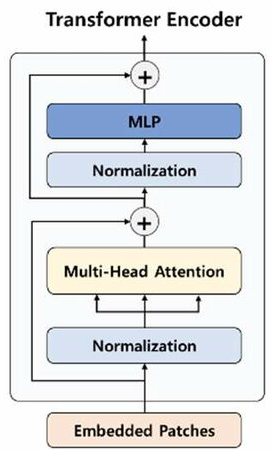

#### Siglip Multi Layer Perceptron
Implemented in SiglipMLP class. Why MLP?
* Self-attention mixes information across spatial positions (tokens/patches). By itself, attention is linear in the feature dimension (it projects but doesn’t add non-linear complexity across channels).
* The MLP introduces non-linearity and depth within each position (token or patch), using **GELU** (Gaussian Error Linear Unit) activation to enable richer feature transformations. Note: the choice of GELU is heuristic, based on empirical performance in Transformer architectures rather than theoretical justification.

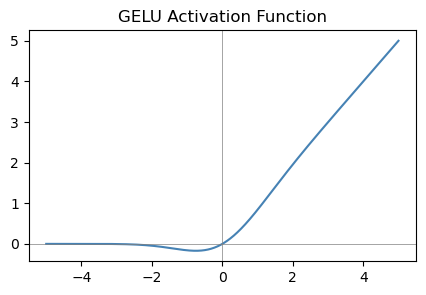

In [10]:
x = torch.linspace(-5, 5, steps=1000)
y = nn.functional.gelu(x)
plt.figure(figsize=(5, 3))
plt.plot(x.numpy(), y.numpy(), color='steelblue')
plt.title("GELU Activation Function")
plt.axhline(0, color='gray', linewidth=0.5)
plt.axvline(0, color='gray', linewidth=0.5);

In [4]:
z = torch.tensor([-2.0, -1.0, -0.5, 0.0, 0.5, 1.0, 2.0])
print(f"Gelu doesn't hard-clips negatives to zero\nz      : {z}\ngelu(z): {nn.functional.gelu(z, approximate='tanh')}")

Gelu doesn't hard-clips negatives to zero
z      : tensor([-2.0000, -1.0000, -0.5000,  0.0000,  0.5000,  1.0000,  2.0000])
gelu(z): tensor([-0.0454, -0.1588, -0.1543,  0.0000,  0.3457,  0.8412,  1.9546])


#### Note on reshaping inputs for Multi-Head Attention
* Multi-head attention is implemented using tensor reshaping and batched matrix multiplications
* Heads are simulated by slicing and reshaping tensors, and multi-head attention is computed in one batched operation for all heads simultaneously.
* Each head should learn to relate tokens (or patches) differently.
```python
# Original query tensor: [batch_size, seq_len, embed_dim] = [1, 2, 4]
Q = torch.tensor([[
    [1.0, 2.0, 3.0, 4.0],   # token 1
    [5.0, 6.0, 7.0, 8.0]    # token 2
]])

# Reshape to [batch_size, seq_len, num_heads, d_k], where d_k = embed_dim/num_heads
Q_viewed = Q.view(batch_size, seq_len, num_heads, d_k)
torch.tensor([[
  [[1., 2.], [3., 4.]],   # token 1: [1, 2] → head 0, [3, 4] → head 1
  [[5., 6.], [7., 8.]]    # token 2: [5, 6] → head 0, [7, 8] → head 1
]])

# Transpose to [batch_size, num_heads, seq_len, d_k]
Q_transposed = Q_viewed.transpose(1, 2)
torch.tensor([[
  [[1., 2.], [5., 6.]],   # head 0: half part of token 1 and token 2 divided along embed_dim
  [[3., 4.], [7., 8.]]    # head 1: the other half part of token 1 and token 2
]])

In [2]:
# Based on Umar Jamil's implementation: https://github.com/hkproj/pytorch-paligemma
# Annotated with additional notes for educational purposes by Welly Wong
class SiglipVisionConfig:
    """
    Configuration class for the Siglip Vision Transformer model.
    """
    def __init__(
        self,
        hidden_size=1152,          # size of the embedding vector (embed_dim) of the vision transformer
        intermediate_size=4304,    # up-projection size
        num_hidden_layers=27,      # the number of transformer encoder layer, stacked sequentially
        num_attention_heads=16,    # number of attention head in the multi head attention
        num_channels=3,            # the number of channels each image has (RGB)
        patch_size=14,             # kernel_size, the patches are taken with no overlap
        image_size=224,            # Paligemma has 3 different resolutions: 224x224, 448x448, and 896x896 pixels, we use the smallest resolution
        attention_dropout=0.0,
        layer_norm_eps=1e-6,
        num_image_tokens: int = 256,    # the number of image patches: (224/14)**2
        **kwargs,
    ):
        super().__init__()
        self.hidden_size = hidden_size
        self.intermediate_size = intermediate_size
        self.num_hidden_layers = num_hidden_layers
        self.num_attention_heads = num_attention_heads
        self.num_channels = num_channels
        self.patch_size = patch_size
        self.image_size = image_size
        self.attention_dropout = attention_dropout
        self.layer_norm_eps = layer_norm_eps
        self.num_image_tokens = num_image_tokens

class SiglipVisionEmbeddings(nn.Module):
    """
    Converts input images into a sequence of patch embeddings for transformer models.
    Each image is split into non-overlapping patches, projected to `embed_dim`, and
    augmented with learnable positional embeddings.
    """
    def __init__(self, config: SiglipVisionConfig):
        super().__init__()
        self.config = config
        self.embed_dim = config.hidden_size
        self.image_size = config.image_size
        self.patch_size = config.patch_size
        self.patch_embedding = nn.Conv2d(   # Conv2d acts like a patch extractor + linear projection in one
            in_channels=config.num_channels,
            out_channels=self.embed_dim,
            kernel_size=self.patch_size,
            stride=self.patch_size,
            padding="valid",                # 'valid' means no padding
        )
        self.num_patches = (self.image_size // self.patch_size) ** 2   # 256, num_patches is similar to seq_len in language model
        self.num_positions = self.num_patches
        self.position_embedding = nn.Embedding(self.num_positions, self.embed_dim)
        self.register_buffer(
            "position_ids",
            torch.arange(self.num_positions).expand((1, -1)),
            persistent=False,
        )

    def forward(self, pixel_values: torch.FloatTensor) -> torch.Tensor:
        _, _, height, width = pixel_values.shape            # [batch_size, channels, height, width]
        patch_embeds = self.patch_embedding(pixel_values)   # [batch_size, embed_dim, num_patches_h, num_patches_w]
        embeddings = patch_embeds.flatten(2)                # [batch_size, embed_dim, num_patches]
        embeddings = embeddings.transpose(1, 2)             # [batch_size, num_patches, embed_dim]
        embeddings = embeddings + self.position_embedding(self.position_ids)
        return embeddings

class SiglipAttention(nn.Module):
    """
    Implements multi-head self-attention for the Siglip model.
    Projects inputs into queries, keys, and values, applies scaled dot-product attention,
    and combines the results to produce context-aware embeddings.
    """
    def __init__(self, config):
        super().__init__()
        self.config = config
        self.embed_dim = config.hidden_size
        self.num_heads = config.num_attention_heads
        self.head_dim = self.embed_dim // self.num_heads
        self.scale = self.head_dim**-0.5    # scaling factor 1/sqrt(dk)
        self.dropout = config.attention_dropout

        # The learned weights (W_q, W_k, W_v) make the same input behave differently,
        # model learns what kind of queries, keys, and values it needs via training
        self.k_proj = nn.Linear(self.embed_dim, self.embed_dim)     # W_k
        self.v_proj = nn.Linear(self.embed_dim, self.embed_dim)     # W_v
        self.q_proj = nn.Linear(self.embed_dim, self.embed_dim)     # W_q
        self.out_proj = nn.Linear(self.embed_dim, self.embed_dim)   # W_o

    def forward(
        self,
        hidden_states: torch.Tensor,
    ) -> Tuple[torch.Tensor, Optional[torch.Tensor]]:
        # hidden_states: [batch_size, num_patches, embed_dim]
        batch_size, seq_len, _ = hidden_states.size()
        query_states = self.q_proj(hidden_states)
        key_states = self.k_proj(hidden_states)
        value_states = self.v_proj(hidden_states)
        
        # [batch_size, seq_len, embed_dim] -> [batch_size, seq_len, num_heads, head_dim]
        #    -> [batch_size, num_heads, seq_len, head_dim]
        query_states = query_states.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        key_states = key_states.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        value_states = value_states.view(batch_size, seq_len, self.num_heads, self.head_dim).transpose(1, 2)
        
        # attn_weights: [batch_size, num_heads, seq_len, seq_len]
        attn_weights = (torch.matmul(query_states, key_states.transpose(2, 3)) * self.scale)
        if attn_weights.size() != (batch_size, self.num_heads, seq_len, seq_len):
            raise ValueError(
                f"Attention weights should be of size {(batch_size, self.num_heads, seq_len, seq_len)}, but is"
                f" {attn_weights.size()}"
            )
        # apply the softmax row-wise
        attn_weights = nn.functional.softmax(attn_weights, dim=-1, dtype=torch.float32).to(query_states.dtype)

        # apply dropout only during training
        attn_weights = nn.functional.dropout(attn_weights, p=self.dropout, training=self.training)

        # Take the weighted sum of all values, using the attn scores as weights, this is done simultaneously for each head
        attn_output = torch.matmul(attn_weights, value_states)   # [batch_size, num_heads, seq_len, head_dim]
        if attn_output.size() != (batch_size, self.num_heads, seq_len, self.head_dim):
            raise ValueError(
                f"`attn_output` should be of size {(batch_size, self.num_heads, seq_len, self.head_dim)}, but is"
                f" {attn_output.size()}"
            )            
        # [batch_size, seq_len, num_heads, head_dim], reorders dimensions to prepare for concatenating all heads
        attn_output = attn_output.transpose(1, 2).contiguous()
        
        # [batch_size, seq_len, embed_dim], can actually use .view() here since we already allocated contiguous memory
        attn_output = attn_output.reshape(batch_size, seq_len, self.embed_dim)

        # W_o (out_proj) learns to combine information across all heads
        attn_output = self.out_proj(attn_output)
        return attn_output, attn_weights

class SiglipMLP(nn.Module):
    """
    Feed-forward MLP block for the Siglip model.
    Projects inputs to a higher-dimensional intermediate space, applies GELU non-linearity,
    and projects back to the original embedding dimension.
    """
    def __init__(self, config):
        super().__init__()
        self.config = config
        self.fc1 = nn.Linear(config.hidden_size, config.intermediate_size)
        self.fc2 = nn.Linear(config.intermediate_size, config.hidden_size)

    def forward(self, hidden_states: torch.Tensor) -> torch.Tensor:
        # [batch_size, num_patches, embed_dim] -> [batch_size, num_patches, intermediate_size]
        hidden_states = self.fc1(hidden_states)
        hidden_states = nn.functional.gelu(hidden_states, approximate="tanh")   # apply non-linearity
        
        # [batch_size, num_patches, intermediate_size] -> [batch_size, num_patches, embed_dim]
        hidden_states = self.fc2(hidden_states)
        return hidden_states

class SiglipEncoderLayer(nn.Module):
    """
    Single transformer encoder layer for the Siglip model.
    Applies multi-head self-attention and a feed-forward MLP, each followed by layer normalization
    and residual connections to maintain the input shape [batch_size, num_patches, embed_dim].
    """
    def __init__(self, config: SiglipVisionConfig):
        super().__init__()
        self.embed_dim = config.hidden_size
        self.self_attn = SiglipAttention(config)
        self.layer_norm1 = nn.LayerNorm(self.embed_dim, eps=config.layer_norm_eps)
        self.mlp = SiglipMLP(config)
        self.layer_norm2 = nn.LayerNorm(self.embed_dim, eps=config.layer_norm_eps)

    def forward(
        self,
        hidden_states: torch.Tensor
    ) -> torch.Tensor:
        # The shape is maintained: [batch_size, num_patches, embed_dim]
        residual = hidden_states    # save this states for the skip connection
        hidden_states = self.layer_norm1(hidden_states)
        hidden_states, _ = self.self_attn(hidden_states=hidden_states)
        hidden_states = residual + hidden_states
        residual = hidden_states   # save this states for the 2nd skip connection
        hidden_states = self.layer_norm2(hidden_states)
        hidden_states = self.mlp(hidden_states) 
        hidden_states = residual + hidden_states      
        return hidden_states

class SiglipEncoder(nn.Module):
    """
    Stack of transformer encoder layers for the Siglip model.
    Sequentially applies multiple SiglipEncoderLayer modules to input embeddings.
    """
    def __init__(self, config: SiglipVisionConfig):
        super().__init__()
        self.config = config
        self.layers = nn.ModuleList(
            [SiglipEncoderLayer(config) for _ in range(config.num_hidden_layers)]
        )

    def forward(
        self,
        inputs_embeds: torch.Tensor
    ) -> torch.Tensor:
        # The shape is maintained: [batch_size, num_patches, embed_dim]
        hidden_states = inputs_embeds
        for encoder_layer in self.layers:
            hidden_states = encoder_layer(hidden_states)
        return hidden_states

class SiglipVisionTransformer(nn.Module):
    """
    Vision transformer backbone for the Siglip model.
    Converts input images into patch embeddings, processes them through a stack of encoder layers,
    and applies final layer normalization to produce contextualized patch representations.
    """
    def __init__(self, config: SiglipVisionConfig):
        super().__init__()
        self.config = config
        embed_dim = config.hidden_size
        self.embeddings = SiglipVisionEmbeddings(config)
        self.encoder = SiglipEncoder(config)
        self.post_layernorm = nn.LayerNorm(embed_dim, eps=config.layer_norm_eps)

    def forward(self, pixel_values: torch.Tensor) -> torch.Tensor:
        # [batch_size, channels, height, width] -> [batch_size, num_patches, embed_dim]
        hidden_states = self.embeddings(pixel_values)
        last_hidden_state = self.encoder(inputs_embeds=hidden_states)
        last_hidden_state = self.post_layernorm(last_hidden_state)
        return last_hidden_state

class SiglipVisionModel(nn.Module):
    """
    Wrapper around the SiglipVisionTransformer.
    Takes images as input and returns the corresponding patch-level embeddings.
    """
    def __init__(self, config: SiglipVisionConfig):
        super().__init__()
        self.config = config
        self.vision_model = SiglipVisionTransformer(config)

    def forward(self, pixel_values) -> Tuple:
        # [batch_size, channels, height, width] -> [batch_size, num_patches, embed_dim]
        return self.vision_model(pixel_values=pixel_values) 

In [3]:
# Based on Umar Jamil's implementation: https://github.com/hkproj/pytorch-paligemma
# Annotated with additional notes for educational purposes by Welly Wong
# Image was first scaled to [0, 1] (dividing pixel values by 255.), 
# (image - 0.5) / 0.5 transforms it to the symmetric range [-1, 1]
IMAGENET_STANDARD_MEAN = [0.5, 0.5, 0.5]   # IMAGENET_MEAN = [0.485, 0.456, 0.406], but hugging face doesn't use this
IMAGENET_STANDARD_STD = [0.5, 0.5, 0.5]    # IMAGENET_STD = [0.229, 0.224, 0.225]

def add_image_tokens_to_prompt(prefix_prompt, bos_token, image_seq_len, image_token):
    """
    Prepares a prompt for PaliGemma by prepending image tokens and the beginning-of-sequence token.
    PaliGemma was trained using a newline character ('\n') to signal the end of the prompt,
    so this function appends it at the end. Note that although the original paper suggests
    tokenizing '\n' separately, the Hugging Face implementation does not do this.
    """
    return f"{image_token * image_seq_len}{bos_token}{prefix_prompt}\n"

def resize(image: Image, size: Tuple[int, int], resample: Image.Resampling=None,
           reducing_gap: Optional[int]=None) -> np.ndarray:
    """
    Resizes a PIL image to the specified (height, width) using optional resampling and reducing gap.
    """
    height, width = size
    resized_image = image.resize(   # .resize() is a method of the Pillow (PIL) Image class
        (width, height), resample=resample, reducing_gap=reducing_gap
    )
    return resized_image

def rescale(image: np.ndarray, scale: float, dtype: np.dtype=np.float32) -> np.ndarray:
    """
    Rescales image pixel values by a given factor and casts to the specified data type.
    """
    rescaled_image = image * scale     # rescale by factor: 1 / 255.0
    rescaled_image = rescaled_image.astype(dtype)
    return rescaled_image

def normalize(image: np.ndarray, mean: Union[float, Iterable[float]], 
              std: Union[float, Iterable[float]]) -> np.ndarray:
    """
    Normalizes image pixels by subtracting the mean and dividing by the standard deviation.
    """
    mean = np.array(mean, dtype=image.dtype)
    std = np.array(std, dtype=image.dtype)
    image = (image - mean) / std
    return image

def process_images(images: List[Image.Image], 
                   size: Dict[str, int] = None, 
                   resample: Image.Resampling = None,
                   rescale_factor: float = None,
                   image_mean: Optional[Union[float, List[float]]] = None,
                   image_std: Optional[Union[float, List[float]]] = None) -> List[np.ndarray]:
    """
    Preprocessing pipeline for a list of images.
    Resizes, converts to numpy arrays, rescales, normalizes, and transposes to [channel, height, width] format.
    """
    height, width = size[0], size[1]
    images = [
        resize(image=image, size=(height, width), resample=resample) for image in images
    ]
    images = [np.array(image) for image in images]
    images = [rescale(image, scale=rescale_factor) for image in images]
    images = [normalize(image, mean=image_mean, std=image_std) for image in images]
 
    # Model expects images in: [channel, height, width], PIL Image: [height, width, channel]
    images = [image.transpose(2, 0, 1) for image in images]
    return images

class PaliGemmaProcessor:
    """
    Prepares text and images for the PaliGemma model. 
    Adds special tokens for images, object locations, and segmentation, 
    and converts input images to normalized tensors while tokenizing text prompts.
    """
    IMAGE_TOKEN = "<image>"  # Acts as a special placeholder token
    def __init__(self, tokenizer, num_image_tokens: int, image_size: int):
        super().__init__()
        self.image_seq_length = num_image_tokens
        self.image_size = image_size
        tokens_to_add = {"additional_special_tokens": [self.IMAGE_TOKEN]}
        tokenizer.add_special_tokens(tokens_to_add)
        EXTRA_TOKENS = [
            f"<loc{i:04d}>" for i in range(1024)
        ]  # For object detection, where each token can represent a discrete bounding box location.
        EXTRA_TOKENS += [
            f"<seg{i:03d}>" for i in range(128)
        ]  # For object segmentation, where each token can refer to a segmentation mask class or region.
        tokenizer.add_tokens(EXTRA_TOKENS)
        self.image_token_id = tokenizer.convert_tokens_to_ids(self.IMAGE_TOKEN)
        tokenizer.add_bos_token = False
        tokenizer.add_eos_token = False
        self.tokenizer = tokenizer

    def __call__(self, text: List[str], images: List[Image.Image],
                 padding: str = "longest", truncation: bool = False) -> dict:
        #assert len(images) == 1 and len(text) == 1, f'Received {len(images)} images for {len(text)} prompts.'
        pixel_values = process_images(
            images,
            size = (self.image_size, self.image_size),
            resample = Image.Resampling.BICUBIC,
            rescale_factor = 1 / 255.0,
            image_mean = IMAGENET_STANDARD_MEAN,
            image_std = IMAGENET_STANDARD_STD,
        )
        # Convert the list of numpy arrays to a single numpy array with shape [batch_size, channels, height, width]
        pixel_values = np.stack(pixel_values, axis=0)

        # Convert numpy array to PyTorch tensor
        pixel_values = torch.tensor(pixel_values)

        # ["{image_token * image_seq_len}{bos_token}{prefix_prompt}\n"] for each prompt
        input_strings = [
            add_image_tokens_to_prompt(
                prefix_prompt = prompt,
                bos_token = self.tokenizer.bos_token,
                image_seq_len = self.image_seq_length,
                image_token = self.IMAGE_TOKEN,
            )
            for prompt in text
        ]
        # Tokenizer returns input_ids (indices in the tokenizer's vocabulary) and attention_mask as PyTorch tensors
        inputs = self.tokenizer(input_strings, return_tensors='pt', padding=padding, truncation=truncation)
        return_data = {'pixel_values': pixel_values, **inputs}
        return return_data

#### Gemma2B Multi Query Attention
Multi Query Attention is a variant of the standard multi-head attention mechanism where:
* There are multiple query heads.
* But only a single key head and a single value head (shared across all queries).

K and 𝑉 are literally the same tensors in memory for all heads. The only head-specific thing is Q, which changes the attention weights and therefore changes how each head uses the shared values.

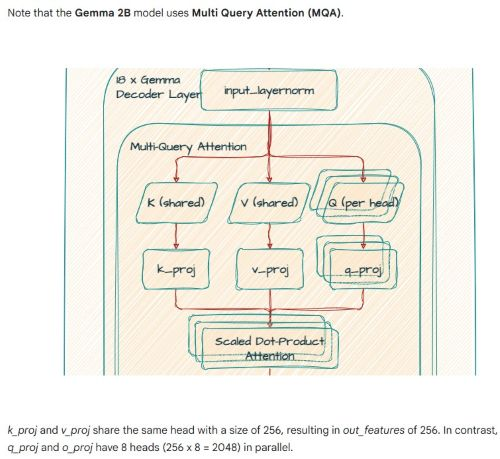

*Image from: https://developers.googleblog.com/en/gemma-explained-overview-gemma-model-family-architectures/*

#### Weight Tying
Implemented in the `GemmaForCausalLM` class as `tie_weights` method.

Weight tying is a technique where the **same weight matrix** is used for both:
* The **input embedding layer**, which maps token IDs to vector representations, and
* The **output projection layer**, which maps hidden states back to vocabulary logits.
* Theoretical motivation: It's symmetric, if you're using a token to represent meaning (via embedding), it makes sense to use the same representation when predicting that token

#### PaliGemma’s Prefix-LM masking
Block attention throughout image and prefix, autoregressive attention on the suffix:
* The prefix block (image + input + special tokens like [bos], [sep]) uses full bidirectional attention.
* Only suffix/target tokens use causal masking, which ensures autoregressive behavior.

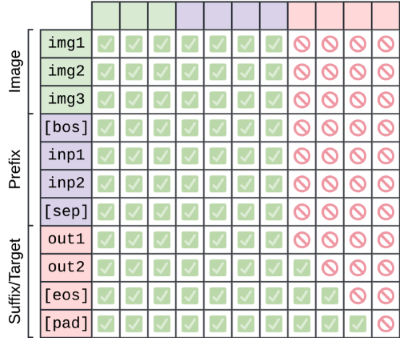

#### KV Cache
In transformer decoding, we often generate tokens one at a time, and we want to avoid recomputing the attention keys/values for all previous tokens. So we cache them instead for each transformer layer.

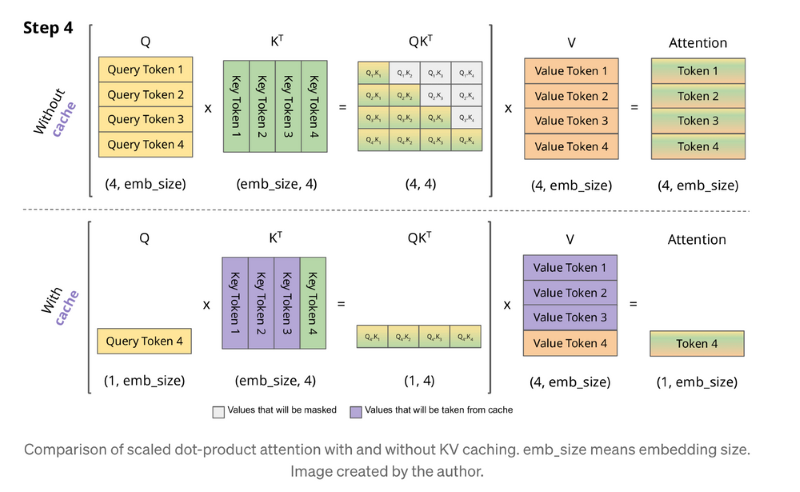

*Image credit: https://pangyoalto.com/content/images/size/w1000/2024/03/Screen-Shot-2024-03-12-at-11.08.40-PM.png*

#### Gemma Gated MLP
Implemented in GemmaMLP class, we have two parallel projections from the same input:
* Gate path:
gate = GELU(W_gate * x)
This produces numbers between roughly 0 and 1

* Value path:
value = W_up * x
This is the actual transformed information we might want to keep or discard.

* Multiplication:
gated_output = gate * value
This is element-wise, meaning for every neuron in the intermediate space, the gate decides how strongly that neuron’s signal gets passed on.

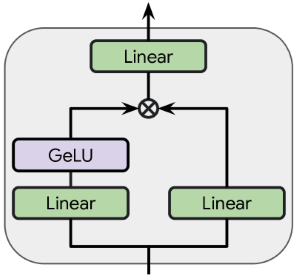

In [4]:
# Based on Umar Jamil's implementation: https://github.com/hkproj/pytorch-paligemma
# Annotated with additional notes for educational purposes by Welly Wong
class KVCache():
    """
    Key-value cache for storing past attention states in transformer layers.
    """
    def __init__(self) -> None:
        self.key_cache: List[torch.Tensor] = []
        self.value_cache: List[torch.Tensor] = []
    
    def num_items(self) -> int:
        if len(self.key_cache) == 0:
            return 0
        else:
            return self.key_cache[0].shape[-2]   # [batch_size, num_head_kv, seq_len, head_dim]

    def update(
        self,
        key_states: torch.Tensor,
        value_states: torch.Tensor,
        layer_idx: int,
    ) -> Tuple[torch.Tensor, torch.Tensor]:
        if len(self.key_cache) <= layer_idx:
            self.key_cache.append(key_states)
            self.value_cache.append(value_states)
        else:
            # Concatenate along the seq_len dimension
            self.key_cache[layer_idx] = torch.cat([self.key_cache[layer_idx], key_states], dim=-2)
            self.value_cache[layer_idx] = torch.cat([self.value_cache[layer_idx], value_states], dim=-2)
        return self.key_cache[layer_idx], self.value_cache[layer_idx]

class GemmaConfig():
    def __init__(
        self,
        vocab_size=257216,
        max_position_embeddings=8192,
        hidden_size=2048,
        intermediate_size=16384,
        num_hidden_layers=18,
        num_attention_heads=8,
        head_dim=256,
        num_key_value_heads=1,
        rms_norm_eps=1e-6,
        rope_theta=10000.0,
        attention_bias=False,
        attention_dropout=0.0,
        pad_token_id=None,
        **kwargs,
    ):
        super().__init__()
        self.vocab_size = vocab_size
        self.max_position_embeddings = max_position_embeddings
        self.hidden_size = hidden_size
        self.intermediate_size = intermediate_size
        self.num_hidden_layers = num_hidden_layers
        self.num_attention_heads = num_attention_heads
        self.head_dim = head_dim
        self.num_key_value_heads = num_key_value_heads
        self.rms_norm_eps = rms_norm_eps
        self.rope_theta = rope_theta
        self.attention_bias = attention_bias
        self.attention_dropout = attention_dropout
        self.pad_token_id = pad_token_id

class PaliGemmaConfig():
    def __init__(
        self,
        vision_config=None,
        text_config=None,
        ignore_index=-100,
        image_token_index=257152,
        vocab_size=257216,
        projection_dim=2048,
        hidden_size=2048,
        pad_token_id=0,
        **kwargs,
    ):
        super().__init__()
        self.ignore_index = ignore_index
        self.image_token_index = image_token_index
        self.vocab_size = vocab_size
        self.projection_dim = projection_dim
        self.hidden_size = hidden_size
        self.is_encoder_decoder = False
        self.pad_token_id = pad_token_id
        self.vision_config = SiglipVisionConfig(**vision_config)
        self.text_config = GemmaConfig(**text_config, pad_token_id=pad_token_id)
        self.vocab_size = self.text_config.vocab_size
        self.text_config.num_image_tokens = (self.vision_config.image_size // self.vision_config.patch_size) ** 2
        self.vision_config.projection_dim = projection_dim

class GemmaRMSNorm(nn.Module):
    """
    Root Mean Square Layer Normalization (RMSNorm) for the Gemma model.
    Normalizes inputs based on their RMS and applies a learnable scaling, initialized to identity.
    """
    def __init__(self, dim: int, eps: float = 1e-6):
        super().__init__()
        self.eps = eps
        self.weight = nn.Parameter(torch.zeros(dim))

    def _norm(self, x):
        return x * torch.rsqrt(x.pow(2).mean(-1, keepdim=True) + self.eps)

    def forward(self, x):
        output = self._norm(x.float())
        # Why (1.0 + weight): init with weight=0 means the scale is initially 1.0 (identity transform)
        # Training adjusts it slightly, avoiding instability at initialization
        output = output * (1.0 + self.weight.float())
        return output.type_as(x)

class GemmaRotaryEmbedding(nn.Module):
    """
    Implements rotary positional embeddings for the Gemma model.
    """
    def __init__(self, dim, max_position_embeddings=8192, base=10000, device=None):
        super().__init__()
        self.dim = dim    # set to the head_dim
        self.max_position_embeddings = max_position_embeddings
        self.base = base
        # Calculate theta according to the formula theta_i = base**(-2*i/dim) where i = 0, 1, 2, ..., dim // 2
        inv_freq = 1.0 / (self.base ** (torch.arange(0, self.dim, 2, dtype=torch.int64).float() / self.dim))
        self.register_buffer("inv_freq", tensor=inv_freq, persistent=False)

    @torch.no_grad()
    def forward(self, x, position_ids, seq_len=None):
        # x: [batch_size, num_attention_heads, seq_len, head_size]
        self.inv_freq.to(x.device)

        # inv_freq_expanded: [batch_size, head_dim //2 , 1]
        inv_freq_expanded = self.inv_freq[None, :, None].float().expand(position_ids.shape[0], -1, 1)
        
        # position_ids_expanded: [batch_size, 1, seq_len]
        position_ids_expanded = position_ids[:, None, :].float()
        device_type = x.device.type
        device_type = device_type if isinstance(device_type, str) and device_type != "mps" else "cpu"

        # We want to retain full precision, and so we disable autocast (automatic mixed precision)
        with torch.autocast(device_type=device_type, enabled=False):
            # Multiply each theta by the position (which is the argument of the sin and cos functions)
            # freqs: [batch_size, head_dim //2, 1] @ [batch_size, 1, seq_len] -> [batch_size, head_dim // 2, seq_len]
            #          -> [batch_size, seq_len, head_dim //2]
            freqs = (inv_freq_expanded.float() @ position_ids_expanded.float()).transpose(1, 2)
            emb = torch.cat((freqs, freqs), dim=-1)   # [batch_size, seq_len, head_dim]
            cos = emb.cos()
            sin = emb.sin()
        return cos.to(dtype=x.dtype), sin.to(dtype=x.dtype)

def rotate_half(x):
    """
    Performs a 90° rotation on the last dimension by splitting it in half,
    negating the second half, and swapping the two halves. 
    This is an alternative implementation to the one in the original paper 
    (see: https://github.com/huggingface/transformers/issues/25199).
    """
    x1 = x[..., : x.shape[-1] // 2]    # Takes the first half of the last dimension
    x2 = x[..., x.shape[-1] // 2 :]    # Takes the second half of the last dimension
    return torch.cat((-x2, x1), dim=-1)

def apply_rotary_pos_emb(q, k, cos, sin, unsqueeze_dim=1):
    # [batch_size, seq_len, head_dim] -> [batch_size, 1, seq_len, head_dim]
    cos = cos.unsqueeze(unsqueeze_dim)
    sin = sin.unsqueeze(unsqueeze_dim)
    # Apply the formula (equation 34) of the Rotary Positional Encoding paper.
    q_embed = (q * cos) + (rotate_half(q) * sin)
    k_embed = (k * cos) + (rotate_half(k) * sin)
    return q_embed, k_embed

class GemmaMLP(nn.Module):
    """
    Gated feed-forward MLP block for the Gemma model.
    Applies a GELU-activated gating mechanism by combining `gate_proj` and `up_proj`,
    then projects back to the original hidden dimension with `down_proj`.
    """
    def __init__(self, config):
        super().__init__()
        self.config = config
        self.hidden_size = config.hidden_size
        self.intermediate_size = config.intermediate_size
        self.gate_proj = nn.Linear(self.hidden_size, self.intermediate_size, bias=False)
        self.up_proj = nn.Linear(self.hidden_size, self.intermediate_size, bias=False)
        self.down_proj = nn.Linear(self.intermediate_size, self.hidden_size, bias=False)

    def forward(self, x):
        return self.down_proj(nn.functional.gelu(self.gate_proj(x), approximate="tanh") * self.up_proj(x))

def repeat_kv(hidden_states: torch.Tensor, n_rep: int) -> torch.Tensor:
    """
    Repeats key/value hidden states for multi-query attention.
    Expands the tensor along the head dimension `n_rep` times and reshapes
    to match the expected number of attention heads.
    """
    bsz, num_key_value_heads, q_len, head_dim = hidden_states.shape
    if n_rep == 1:
        return hidden_states
    hidden_states = hidden_states[:, :, None, :, :].expand(bsz, num_key_value_heads, n_rep, q_len, head_dim)
    return hidden_states.reshape(bsz, num_key_value_heads * n_rep, q_len, head_dim)

class GemmaAttention(nn.Module):
    """
    Multi-head attention module for the Gemma model with support for rotary positional embeddings.
    Projects inputs into queries, keys, and values, applies causal attention, and optionally uses
    key-value caching for efficient autoregressive decoding.
    """
    def __init__(self, config: GemmaConfig, layer_idx: Optional[int]=None):
        super().__init__()
        self.config = config
        self.layer_idx = layer_idx
        self.attention_dropout = config.attention_dropout
        self.hidden_size = config.hidden_size                                    # 2048
        self.num_heads = config.num_attention_heads                              # 8
        self.head_dim = config.head_dim                                          # 256 (2048/8)
        self.num_key_value_heads = config.num_key_value_heads                    # 1
        self.num_key_value_groups = self.num_heads // self.num_key_value_heads   # 8
        self.max_position_embeddings = config.max_position_embeddings            # 8192
        self.rope_theta = config.rope_theta                                      # 10000. (base freq of RoPE)
        self.is_causal = True
        assert self.hidden_size % self.num_heads == 0 
        # Note: the weight matrix of a linear layer is of shape (out_features, in_features)
        self.q_proj = nn.Linear(self.hidden_size, self.num_heads * self.head_dim, bias=config.attention_bias)            # Wq: (2048, 2048)
        self.k_proj = nn.Linear(self.hidden_size, self.num_key_value_heads * self.head_dim, bias=config.attention_bias)  # Wk: (256, 2048)
        self.v_proj = nn.Linear(self.hidden_size, self.num_key_value_heads * self.head_dim, bias=config.attention_bias)  # Wv: (256, 2048)
        self.o_proj = nn.Linear(self.num_heads * self.head_dim, self.hidden_size, bias=config.attention_bias)            # Wo: (2048, 2048)
        self.rotary_emb = GemmaRotaryEmbedding(
            self.head_dim,
            max_position_embeddings=self.max_position_embeddings,
            base=self.rope_theta,
        )

    def forward(
        self,
        hidden_states: torch.Tensor,
        attention_mask: Optional[torch.Tensor] = None,
        position_ids: Optional[torch.LongTensor] = None,
        kv_cache: Optional[KVCache] = None,
        **kwargs,
    ) -> Tuple[torch.Tensor, Optional[torch.Tensor], Optional[Tuple[torch.Tensor]]]:
        bsz, q_len, _ = hidden_states.size()
        
        # [batch_size, seq_len, 2048] -> [batch_size, seq_len, 2048]
        query_states = self.q_proj(hidden_states)
        
        # [batch_size, seq_len, 2048] -> [batch_size, seq_len, 256]
        key_states = self.k_proj(hidden_states)
        value_states = self.v_proj(hidden_states)
        
        # [batch_size, 8, seq_len, 256]
        query_states = query_states.view(bsz, q_len, self.num_heads, self.head_dim).transpose(1, 2)
        
        # [batch_size, 1, seq_len, 256]
        key_states = key_states.view(bsz, q_len, self.num_key_value_heads, self.head_dim).transpose(1, 2)
        value_states = value_states.view(bsz, q_len, self.num_key_value_heads, self.head_dim).transpose(1, 2)

        # [batch_size, seq_len, 256], [batch_size, seq_len, 256]
        cos, sin = self.rotary_emb(value_states, position_ids, seq_len=None)
        
        # [batch_size, 8, seq_len, 256], [batch_size, 1, seq_len, 256]
        query_states, key_states = apply_rotary_pos_emb(query_states, key_states, cos, sin)

        if kv_cache is not None:
            key_states, value_states = kv_cache.update(key_states, value_states, self.layer_idx)

        # Repeat the key and values so we have the same number of heads as the query
        key_states = repeat_kv(key_states, self.num_key_value_groups)
        value_states = repeat_kv(value_states, self.num_key_value_groups)

        attn_weights = torch.matmul(query_states, key_states.transpose(2, 3)) / math.sqrt(self.head_dim)
        assert attention_mask is not None   # attn mask has 0 for tokens to attend to, -inf for tokens to mask out
        attn_weights = attn_weights + attention_mask
        attn_weights = nn.functional.softmax(attn_weights, dim=-1, dtype=torch.float32).to(query_states.dtype)
        attn_weights = nn.functional.dropout(attn_weights, p=self.attention_dropout, training=self.training)
        attn_output = torch.matmul(attn_weights, value_states)
        if attn_output.size() != (bsz, self.num_heads, q_len, self.head_dim):
            raise ValueError(
                f"`attn_output` should be of size {(bsz, self.num_heads, q_len, self.head_dim)}, but is"
                f" {attn_output.size()}"
            )
        # [batch_size, num_heads, seq_len, head_dim] -> [batch_size, seq_len, num_heads, head_dim]
        attn_output = attn_output.transpose(1, 2).contiguous()
        
        # [batch_size, seq_len, num_heads * head_dim]
        attn_output = attn_output.view(bsz, q_len, -1)
        
        # Multiply by Wo, why? -> 'mixing' the concatenated output from each head, so it's not just a concatenation
        # of multiple independent heads
        attn_output = self.o_proj(attn_output)
        return attn_output, attn_weights

class GemmaDecoderLayer(nn.Module):
    """
    Single decoder layer for the Gemma model.
    Applies RMS-normalized self-attention followed by a feed-forward MLP, with residual connections
    after each sublayer to maintain the input shape [batch_size, seq_len, hidden_size].
    """
    def __init__(self, config: GemmaConfig, layer_idx: int):
        super().__init__()
        self.hidden_size = config.hidden_size
        self.self_attn = GemmaAttention(config=config, layer_idx=layer_idx)
        self.mlp = GemmaMLP(config)
        self.input_layernorm = GemmaRMSNorm(config.hidden_size, eps=config.rms_norm_eps)
        self.post_attention_layernorm = GemmaRMSNorm(config.hidden_size, eps=config.rms_norm_eps)

    def forward(
        self,
        hidden_states: torch.Tensor,
        attention_mask: Optional[torch.Tensor] = None,
        position_ids: Optional[torch.LongTensor] = None,
        kv_cache: Optional[KVCache] = None,
    ) -> Tuple[torch.FloatTensor, Optional[Tuple[torch.FloatTensor, torch.FloatTensor]]]:
        residual = hidden_states   # save current states for skip connection
        # [batch_size, seq_len, hidden_size]
        hidden_states = self.input_layernorm(hidden_states)
        hidden_states, _, = self.self_attn(
            hidden_states=hidden_states,
            attention_mask=attention_mask,
            position_ids=position_ids,
            kv_cache=kv_cache,
        )
        hidden_states = residual + hidden_states
        residual = hidden_states   # save current states for the 2nd skip connection
        hidden_states = self.post_attention_layernorm(hidden_states)
        hidden_states = self.mlp(hidden_states)
        hidden_states = residual + hidden_states
        return hidden_states

class GemmaModel(nn.Module):
    """
    Core decoder-only transformer for the Gemma model.
    Processes input embeddings through a stack of decoder layers with residual connections,
    producing contextualized token representations for autoregressive generation.
    """
    def __init__(self, config: GemmaConfig):
        super().__init__()
        self.config = config
        self.padding_idx = config.pad_token_id
        self.vocab_size = config.vocab_size
        self.embed_tokens = nn.Embedding(config.vocab_size, config.hidden_size, self.padding_idx)
        self.layers = nn.ModuleList(
            [GemmaDecoderLayer(config, layer_idx) for layer_idx in range(config.num_hidden_layers)]
        )
        self.norm = GemmaRMSNorm(config.hidden_size, eps=config.rms_norm_eps)

    def get_input_embeddings(self):
        return self.embed_tokens

    def forward(
        self,
        attention_mask: Optional[torch.Tensor] = None,
        position_ids: Optional[torch.LongTensor] = None,
        inputs_embeds: Optional[torch.FloatTensor] = None,
        kv_cache: Optional[KVCache] = None,
    ) -> torch.FloatTensor:
        # [batch_size, seq_len, hidden_size]
        hidden_states = inputs_embeds
        normalizer = torch.tensor(self.config.hidden_size**0.5, dtype=hidden_states.dtype)
        hidden_states = hidden_states * normalizer       
        for decoder_layer in self.layers:
            hidden_states = decoder_layer(
                hidden_states,
                attention_mask=attention_mask,
                position_ids=position_ids,
                kv_cache=kv_cache,
            )
        hidden_states = self.norm(hidden_states)
        return hidden_states

class GemmaForCausalLM(nn.Module):
    """
    Causal language model wrapper for the Gemma model.
    Maps the decoder’s hidden states to vocabulary logits for autoregressive text generation,
    with optional key-value caching.
    """
    def __init__(self, config):
        super().__init__()
        self.config = config
        self.model = GemmaModel(config)
        self.vocab_size = config.vocab_size

        # The final linear layer that maps hidden states to vocabulary logits.
        # bias=False for weight tying
        self.lm_head = nn.Linear(config.hidden_size, config.vocab_size, bias=False)

    def get_input_embeddings(self):
        # returns the nn.Embedding layer defined in GemmaModel
        return self.model.embed_tokens
    
    def tie_weights(self):
        self.lm_head.weight = self.model.embed_tokens.weight

    def forward(
        self,
        attention_mask: Optional[torch.Tensor] = None,
        position_ids: Optional[torch.LongTensor] = None,
        inputs_embeds: Optional[torch.FloatTensor] = None,
        kv_cache: Optional[KVCache] = None,
    ) -> Tuple:
        # [batch_size, seq_len, hidden_size]
        outputs = self.model(
            attention_mask=attention_mask,
            position_ids=position_ids,
            inputs_embeds=inputs_embeds,
            kv_cache=kv_cache,
        )
        hidden_states = outputs
        logits = self.lm_head(hidden_states)   # [batch_size, seq_len, vocab_size]
        logits = logits.float()
        return_data = {
            "logits": logits,
        }
        if kv_cache is not None:   # Return the updated kv_cache
            return_data["kv_cache"] = kv_cache
        return return_data

class PaliGemmaMultiModalProjector(nn.Module):
    """
    Projects vision features into a shared embedding space for multimodal tasks.
    Applies a linear transformation to map image patch embeddings to the model’s projection dimension.
    """
    def __init__(self, config: PaliGemmaConfig):
        super().__init__()
        self.linear = nn.Linear(config.vision_config.hidden_size, config.vision_config.projection_dim, bias=True)

    def forward(self, image_features):
        # [batch_size, num_patches, embed_dim] -> [batch_size, num_patches, projection_dim]
        hidden_states = self.linear(image_features)
        return hidden_states

class PaliGemmaForConditionalGeneration(nn.Module):
    """
    Multimodal conditional generation model combining a SigLIP vision encoder, a multimodal projection layer, and a Gemma language model. 
    Enables text generation conditioned on both image and text inputs by merging image and text embeddings 
    and feeding them into the decoder-only language model.
    """
    def __init__(self, config: PaliGemmaConfig):
        super().__init__()
        self.config = config
        self.vision_tower = SiglipVisionModel(config.vision_config)        # vision encoder
        self.multi_modal_projector = PaliGemmaMultiModalProjector(config)  # a linear projection layer
        self.vocab_size = config.vocab_size
        language_model = GemmaForCausalLM(config.text_config)
        self.language_model = language_model
        self.pad_token_id = self.config.pad_token_id if self.config.pad_token_id is not None else -1

    def tie_weights(self):
        return self.language_model.tie_weights()

    def _merge_input_ids_with_image_features(
        self, image_features: torch.Tensor, inputs_embeds: torch.Tensor, input_ids: torch.Tensor, attention_mask: torch.Tensor, kv_cache: Optional[KVCache] = None
    ):
        _, _, embed_dim = image_features.shape
        batch_size, sequence_length = input_ids.shape
        dtype, device = inputs_embeds.dtype, inputs_embeds.device
        scaled_image_features = image_features / (self.config.hidden_size**0.5)
    
        # Create an empty tensor that will later be populated with image tokens and text tokens embeddings
        final_embedding = torch.zeros(batch_size, sequence_length, embed_dim, dtype=inputs_embeds.dtype, device=inputs_embeds.device)
        
        # [batch_size, seq_len]  True for text tokens
        text_mask = (input_ids != self.config.image_token_index) & (input_ids != self.pad_token_id)
        
        # [batch_size, seq_len]  True for image tokens
        image_mask = input_ids == self.config.image_token_index
        
        # [batch_size, seq_len]  True for padding tokens
        pad_mask = input_ids == self.pad_token_id

        # We need to expand the masks to the embedding dimension otherwise we can't use them in torch.where
        text_mask_expanded = text_mask.unsqueeze(-1).expand(-1, -1, embed_dim)
        pad_mask_expanded = pad_mask.unsqueeze(-1).expand(-1, -1, embed_dim)
        image_mask_expanded = image_mask.unsqueeze(-1).expand(-1, -1, embed_dim)

        # Add the text embeddings
        final_embedding = torch.where(text_mask_expanded, inputs_embeds, final_embedding)

        # Insert image embeddings. We can't use torch.where because the sequence length of scaled_image_features 
        # is not equal to the sequence length of the final embedding
        final_embedding = final_embedding.masked_scatter(image_mask_expanded, scaled_image_features)
        
        # Zero out padding tokens
        final_embedding = torch.where(pad_mask_expanded, torch.zeros_like(final_embedding), final_embedding)

        # Create the attention mask
        min_dtype = torch.finfo(dtype).min  # min_dtype: the lowest representable value (negative infinity for softmax masking)
        q_len = inputs_embeds.shape[1]    
        if kv_cache is None or kv_cache.num_items() == 0:
            # Do not mask any token, because we're in the prefill phase
            # This only works when we have no padding
            causal_mask = torch.full(
                (batch_size, q_len, q_len), fill_value=0, dtype=dtype, device=device
            )
        else:
            # Since we are generating tokens, the query must be one single token
            assert q_len == 1
            kv_len = kv_cache.num_items() + q_len
            # Here we don't need to mask anything, since each query should be able to attend all previous tokens. 
            # This only works when we have no padding
            causal_mask = torch.full(
                (batch_size, q_len, kv_len), fill_value=0, dtype=dtype, device=device
            )
        # [batch_size, q_len, kv_len] -> [batch_size, num_heads_q, q_len, kv_len]
        causal_mask = causal_mask.unsqueeze(1)

        if kv_cache is not None and kv_cache.num_items() > 0:
            # The position of the query is just the last position
            position_ids = attention_mask.cumsum(-1)[:, -1]
            if position_ids.dim() == 1:
                position_ids = position_ids.unsqueeze(0)
        else:
            # Create a position_ids based on the size of the attention_mask
            # For masked tokens, use the number 1 as position.
            position_ids = (attention_mask.cumsum(-1)).masked_fill_((attention_mask == 0), 1).to(device)
        return final_embedding, causal_mask, position_ids

    def forward(
        self,
        input_ids: torch.LongTensor = None,
        pixel_values: torch.FloatTensor = None,
        attention_mask: Optional[torch.Tensor] = None,
        kv_cache: Optional[KVCache] = None,
    ) -> Tuple:
        assert torch.all(attention_mask == 1), "The input cannot be padded"      
        # get_input_embeddings() returns nn.Embedding layer
        # get_input_embeddings()(input_ids)    # standard embedding lookup
        inputs_embeds = self.language_model.get_input_embeddings()(input_ids)

        # [batch_size, channels, height, width] -> [batch_size, num_patches, embed_dim]
        selected_image_feature = self.vision_tower(pixel_values.to(inputs_embeds.dtype))
        
        # [batch_size, num_patches, embed_dim] -> [batch_size, num_patches, hidden_size]
        image_features = self.multi_modal_projector(selected_image_feature)

        # Merge the embeddings of the text tokens and the image tokens
        inputs_embeds, attention_mask, position_ids = self._merge_input_ids_with_image_features(image_features, inputs_embeds, input_ids, attention_mask, kv_cache)       
        outputs = self.language_model(
            attention_mask=attention_mask,
            position_ids=position_ids,
            inputs_embeds=inputs_embeds,
            kv_cache=kv_cache,
        )
        return outputs

#### Temperature in test_inference()
When we do:
```python
next_token_logits = torch.softmax(next_token_logits / temperature, dim=-1)
```
* `Temperature > 1.0` : makes the distribution flatter, more random choices (less confident).
* `Temperature < 1.0` : makes the distribution sharper, more confident choices (less random).
* `Temperature = 1.0` : logits unchanged.

In [5]:
# Based on Umar Jamil's implementation: https://github.com/hkproj/pytorch-paligemma
# Annotated with additional notes for educational purposes by Welly Wong
def move_inputs_to_device(model_inputs: dict, device: str):
    """
    Moves all tensors in the model input dictionary to the specified device.
    """
    model_inputs = {k: v.to(device) for k, v in model_inputs.items()}
    return model_inputs

def get_model_inputs(
    processor: PaliGemmaProcessor, prompt: str, image_file_path: str, device: str
):
    """
    Prepares model inputs from a text prompt and an image file.
    Uses the processor to tokenize the prompt and process the image, then moves all inputs to the specified device.
    """
    image = Image.open(image_file_path)
    images = [image]
    prompts = [prompt]
    model_inputs = processor(text=prompts, images=images)
    model_inputs = move_inputs_to_device(model_inputs, device)
    return model_inputs

def _sample_top_p(probs: torch.Tensor, p: float):
    """
    Performs top-p (nucleus) sampling from a probability distribution.
    Keeps the minimal set of tokens whose cumulative probability is > p,
    renormalizes, and samples one token from this subset.
    """
    probs_sort, probs_idx = torch.sort(probs, dim=-1, descending=True)
    probs_sum = torch.cumsum(probs_sort, dim=-1)
    mask = probs_sum - probs_sort > p
    
    # Zero out all the probabilities of tokens that are not selected by the Top p
    probs_sort[mask] = 0.0
    
    # Redistribute the probabilities so that they sum up to 1.
    probs_sort.div_(probs_sort.sum(dim=-1, keepdim=True))
    
    # Sample a token (its index) from the top p distribution
    next_token = torch.multinomial(probs_sort, num_samples=1)
    
    # Get the token position in the vocabulary corresponding to the sampled index
    next_token = torch.gather(probs_idx, -1, next_token)
    return next_token

def test_inference(
    model: PaliGemmaForConditionalGeneration,
    processor: PaliGemmaProcessor,
    device: str,
    prompt: str,
    image_file_path: str,
    max_tokens_to_generate: int,
    temperature: float,
    top_p: float,
    do_sample: bool,
):
    """
    Performs autoregressive text generation for a given prompt and image using PaliGemmaForConditionalGeneration model.
    Generates tokens one at a time, optionally using top-p sampling with temperature, 
    and stops when the maximum number of tokens is reached or the end-of-sequence token is generated.
    Finally, decodes and prints the generated text appended to the prompt.
    """
    model_inputs = get_model_inputs(processor, prompt, image_file_path, device)
    input_ids = model_inputs["input_ids"]
    attention_mask = model_inputs["attention_mask"]
    pixel_values = model_inputs["pixel_values"]
    kv_cache = KVCache()
    stop_token = processor.tokenizer.eos_token_id
    generated_tokens = []
    for _ in range(max_tokens_to_generate):
        outputs = model(
            input_ids=input_ids,
            pixel_values=pixel_values,
            attention_mask=attention_mask,
            kv_cache=kv_cache,
        )
        kv_cache = outputs["kv_cache"]
        next_token_logits = outputs["logits"][:, -1, :]
        if do_sample:
            next_token_logits = torch.softmax(next_token_logits / temperature, dim=-1)
            next_token = _sample_top_p(next_token_logits, top_p)
        else:
            next_token = torch.argmax(next_token_logits, dim=-1, keepdim=True)
        assert next_token.size() == (1, 1)
        next_token = next_token.squeeze(0)   # Remove batch dimension
        generated_tokens.append(next_token)
        if next_token.item() == stop_token:
            break
        # Append the next token to the input
        input_ids = next_token.unsqueeze(-1)
        attention_mask = torch.cat(
            [attention_mask, torch.ones((1, 1), device=input_ids.device)], dim=-1
        )
    generated_tokens = torch.cat(generated_tokens, dim=-1)
    decoded = processor.tokenizer.decode(generated_tokens, skip_special_tokens=True)
    print(prompt + decoded)

In [6]:
def load_hf_model(model_path: str, device: str) -> Tuple[PaliGemmaForConditionalGeneration, AutoTokenizer]:
    """
    Loads a PaliGemma model and its tokenizer from Hugging Face checkpoint.
    Reads the tokenizer, model configuration, and safetensors weights, initializes the model,
    loads the weights, and ties input/output embeddings before returning the model and tokenizer.
    """
    # Load the tokenizer from Huggingface
    tokenizer = AutoTokenizer.from_pretrained(model_path, padding_side="right")
    assert tokenizer.padding_side == "right"

    # Find all the *.safetensors files
    safetensors_files = glob.glob(os.path.join(model_path, "*.safetensors"))

    # Load safetensors_files one by one into the 'tensors' dictionary
    tensors = {}
    for safetensors_file in safetensors_files:
        with safe_open(safetensors_file, framework="pt", device="cpu") as f:
            for key in f.keys():
                tensors[key] = f.get_tensor(key)

    # Load the model's config
    with open(os.path.join(model_path, "config.json"), "r") as f:
        model_config_file = json.load(f)
        config = PaliGemmaConfig(**model_config_file)

    # Create the model using our class implementation (PaliGemmaForConditionalGeneration) and the config
    model = PaliGemmaForConditionalGeneration(config).to(device)

    # Load the state dict of the model using our 'tensor' dictionary
    model.load_state_dict(tensors, strict=False)

    # Share the weights of the input embedding layer with the output projection layer
    model.tie_weights()

    return (model, tokenizer)

### Load the Model with Pretrained Weights
This project uses pretrained weights from Google’s PaliGemma model, which have been made available through the Hugging face model hub:
* [PaliGemma-3B Pretrained Model](https://huggingface.co/google/paligemma-3b-pt-224)

The model weights are stored in the .safetensors format. This command clones both the model definition and the checkpoint files (via Git LFS):

`git lfs install`

`git clone https://huggingface.co/google/paligemma-3b-pt-224`

In [7]:
MODEL_PATH = r"C:/Users/welly/Documents/Course_DataMining_Project/models/paligemma-3b-pt-224"
device = "cuda"

model, tokenizer = load_hf_model(MODEL_PATH, device)
model = model.to(device).eval()

num_image_tokens = model.config.vision_config.num_image_tokens
image_size = model.config.vision_config.image_size
processor = PaliGemmaProcessor(tokenizer, num_image_tokens, image_size)

In [8]:
# Count the number of trainable parameters
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f'The number of trainable parameters for this model is {count_parameters(model):,}')

The number of trainable parameters for this model is 2,923,466,480


In [9]:
model

PaliGemmaForConditionalGeneration(
  (vision_tower): SiglipVisionModel(
    (vision_model): SiglipVisionTransformer(
      (embeddings): SiglipVisionEmbeddings(
        (patch_embedding): Conv2d(3, 1152, kernel_size=(14, 14), stride=(14, 14), padding=valid)
        (position_embedding): Embedding(256, 1152)
      )
      (encoder): SiglipEncoder(
        (layers): ModuleList(
          (0-26): 27 x SiglipEncoderLayer(
            (self_attn): SiglipAttention(
              (k_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (v_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (q_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (out_proj): Linear(in_features=1152, out_features=1152, bias=True)
            )
            (layer_norm1): LayerNorm((1152,), eps=1e-06, elementwise_affine=True)
            (mlp): SiglipMLP(
              (fc1): Linear(in_features=1152, out_features=4304, bias=True)
              (f

### Test Inference

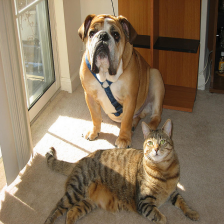

In [10]:
# Prompt 1
prompt = "Where are the animals "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/both.png"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.1, top_p=0.95,do_sample=True)

Where are the animals waiting to go for a walk ?


In [14]:
# Prompt 1 - repeat
prompt = "Where are the animals "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/both.png"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.1, top_p=0.95,do_sample=True)

Where are the animals pet adoptions


In [28]:
# Prompt 1 - repeat
prompt = "Where are the animals "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/both.png"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.2, top_p=0.95,do_sample=True)

Where are the animals in my house


In [24]:
# Prompt 2
prompt = "Where is the sunlight coming from "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/both.png"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.2, top_p=0.95,do_sample=True)

Where is the sunlight coming from window


In [11]:
# Prompt 3
prompt = "Caption the image "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/both.png"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.1, top_p=0.95,do_sample=True)

Caption the image companion


In [25]:
# Prompt 4
prompt = "What animals are in the image "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/both.png"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.2, top_p=0.95,do_sample=True)

What animals are in the image British bulldog, Cat, Dog, Mammal.


### Test Inference: Recognizing Emotions

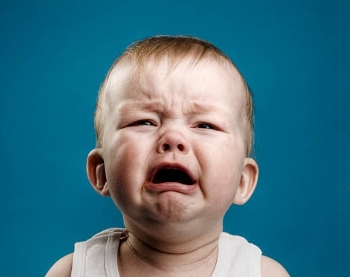

In [21]:
# Prompt 1
prompt = "Describe the child's mood "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/crying_child.jpg"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.1, top_p=0.95,do_sample=True)

Describe the child's mood unhappy


In [24]:
# Prompt 2
prompt = "What is the child doing "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/crying_child.jpg"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.2, top_p=0.95,do_sample=True)

What is the child doing crying


In [26]:
# Prompt 3
prompt = "What might have happened to the child? "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/crying_child.jpg"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.2, top_p=0.95,do_sample=True) 

What might have happened to the child? spanked


In [25]:
# Prompt 3 - repeat
prompt = "What might have happened to the child? "
image_path = r"C:/Users/welly/Documents/Course_DataMining_Project/crying_child.jpg"

with torch.no_grad():
    test_inference(model, processor, device, prompt, image_path, max_tokens_to_generate=100, temperature=1.3, top_p=0.95,do_sample=True) 

What might have happened to the child? leftalone


Interestingly, when prompted with “What might have happened to the child? ”, the model responded with “spanked”, "leftalone". This suggests that the model is capable of rudimentary causal inference based on emotional and contextual cues in the image. While this kind of output is not guaranteed to be accurate or appropriate in all cases, it demonstrates the model’s tendency to associate visual affect with socially learned scenarios, which may be useful for affective captioning or contextual understanding tasks.

### About the Dataset
The dataset used in this project is [Flickr30k on Hugging Face](https://huggingface.co/datasets/nlphuji/flickr30k), a widely-used benchmark in the field of image-captioning and multimodal learning. It consists of 31,014 images collected from the Flickr photo-sharing website, each accompanied by five human-written descriptive sentences. These captions were annotated via Amazon Mechanical Turk (a crowdsourcing marketplace), providing diverse and detailed descriptions that reflect different human perspectives.

For this project, only the first caption associated with each image was used. This decision was made to simplify the alignment between images and text and to reduce computational complexity during embedding and clustering.

The images in the dataset depict a wide range of everyday scenes and human activities, making Flickr30k well-suited for exploring the semantic relationship between visual and textual data.

In [8]:
from datasets import concatenate_datasets
import glob

arrow_path = r"C:\Users\welly\.cache\huggingface\datasets\nlphuji___flickr30k\TEST\1.1.0\2b239befc81b6e3f035ce6bd52f5f4d60f5625f7"

# Find all shard files (9 arrow files)
shards = sorted(glob.glob(os.path.join(arrow_path, "flickr30k-test-*.arrow")))

# Load and concatenate all shards into a single Dataset
datasets_list = [Dataset.from_file(shard) for shard in shards]
dataset = concatenate_datasets(datasets_list)

In [9]:
dataset

Dataset({
    features: ['image', 'caption', 'sentids', 'split', 'img_id', 'filename'],
    num_rows: 31014
})

#### Flickr30k Dataset Processing and Embedding Extraction
Obtain the Flickr30k images for visualization, then pass them through PaliGemma to generate both image and caption embeddings. The Flickr30k dataset provides five human-annotated captions per image; I used only the first caption.

In [10]:
images = list(dataset['image'])  # PIL images
captions = [caps[0] for caps in dataset['caption']]
caption_to_image = list(range(len(dataset["caption"])))

In [11]:
batch_size = 32
img_embs = []
with torch.no_grad():
    for i in range(0, len(images), batch_size):
        batch_imgs = [img.convert('RGB') for img in images[i:i+batch_size]]
        # Preprocess with PaliGemmaProcessor
        inputs = processor(
            text=[""] * len(batch_imgs), 
            images=batch_imgs,
            padding='longest',
            truncation=False,
        )
        pixel_values = inputs['pixel_values'].to(device)          # [batch_size, 3, 224, 224]
        # Forward pass through vision_tower, multi_modal_projector
        vision_out = model.vision_tower(pixel_values)             # [batch_size, seq_len, embed_dim]
        img_proj = model.multi_modal_projector(vision_out)        # [batch_size, seq_len, hidden_dim]
        img_pooled = img_proj.mean(dim=1)                         # [batch_size, hidden_dim]
        img_embs.append(img_pooled.detach().cpu())

img_embs = torch.cat(img_embs, dim=0)  # [num_images, hidden_dim]
print(f'Final image embeddings shape: {img_embs.shape}')

Final image embeddings shape: torch.Size([31014, 2048])


In [12]:
def get_text_embeddings(model, tokenizer, captions, batch_size=32, device='cuda'):
    pad_token_id = model.pad_token_id
    image_token_id = model.config.image_token_index
    all_txt_embs = []
    for i in range(0, len(captions), batch_size):
        batch_caps = captions[i:i+batch_size]
        tokenized = tokenizer(
            batch_caps,
            return_tensors='pt',
            padding='longest',
            truncation=False,
        ).to(device)
        input_ids = tokenized['input_ids']             # [batch_size, seq_len]
        attention_mask = tokenized['attention_mask']   # [batch_size, seq_len]
        with torch.no_grad():
            token_embs = model.language_model.get_input_embeddings()(input_ids)   # [batch_size, seq_len, hidden_dim]
            position_ids = (attention_mask.cumsum(-1)).masked_fill_((attention_mask == 0), 1).to(device)
            q_len = input_ids.shape[1]
            causal_mask = torch.zeros((input_ids.shape[0], 1, q_len, q_len), dtype=token_embs.dtype, device=device)            
            hidden_states = model.language_model.model(
                attention_mask=causal_mask,
                position_ids=position_ids,
                inputs_embeds=token_embs,
                kv_cache=None
            )
            valid_mask = (input_ids != pad_token_id) & (input_ids != image_token_id)
            # pooled = []
            # for b in range(hidden_states.size(0)):    # TODO: too slow, Vectorized!
            #     valid = hidden_states[b][valid_mask[b]]
            #     pooled.append(valid.mean(dim=0) if valid.numel() else torch.zeros(hidden_states.size(-1)))
            # pooled = torch.stack(pooled)    # [batch_size, hidden_dim]
            mask_float = valid_mask.float()   # [batch_size, seq_len]
            
            # Avoid division by zero for mean
            mask_sum = mask_float.sum(dim=1, keepdim=True).clamp(min=1)  # [batch_size, 1]
            
            # Expand for hidden_dim
            mask_expanded = mask_float.unsqueeze(-1)          # [batch_size, seq_len, 1]
            
            # Apply mask to hidden_states
            masked_hidden = hidden_states * mask_expanded     # zeros out invalid tokens
            
            # Mean pooling
            mean_pool = masked_hidden.sum(dim=1) / mask_sum   # [batch_size, hidden_dim]
            
        all_txt_embs.append(mean_pool.detach().cpu())
    return torch.cat(all_txt_embs, dim=0)

In [13]:
txt_embs = get_text_embeddings(model, tokenizer, captions, batch_size=batch_size, device=device)
print(f'Text embeddings shape: {txt_embs.shape}')  # [num_captions, hidden_dim]

Text embeddings shape: torch.Size([31014, 2048])


In [17]:
torch.save({
    "img_embs": img_embs,                          # [num_images, hidden_dim]
    "txt_embs": txt_embs,                          # [num_captions, hidden_dim]
    "caption_to_image": caption_to_image           # [num_captions]: int indices
}, "flickr30k_embs.pt")                            # 484 MB, flickr30k_embs_10k.pt for testing is 156 MB

#### Load the saved image embeddings and text embeddings

In [11]:
# Load the saved dictionary
data = torch.load("flickr30k_embs.pt", weights_only=True)

# Access individual components
img_embs = data["img_embs"]
txt_embs = data["txt_embs"]
caption_to_image = data["caption_to_image"]

### Cross-Modal Retrieval Task
The retrieval task demonstrates the cross-modal capabilities of the PaliGemma model:
* Given a **text query**, it retrieves the most relevant **images**.

This task builds upon the previous section, where image embeddings were derived from the Flickr30k dataset using PaliGemma. The Flickr30k dataset, which contains over 30k images with human-annotated captions per image, was first loaded and concatenated from several shard files into a unified test set. The images were then processed in batches of 32, each batch passed through the model’s vision tower and subsequently the multimodal projector. The resulting sequence embeddings were averaged across the sequence dimension to produce a single fixed-length representation per image. Together, these steps yielded a matrix of image embeddings that served as the retrieval database.

For the retrieval step, a natural language query was encoded using the GemmaForCausalLM component of the model to obtain a text embedding. Since both image and text embeddings reside in the same latent space, similarity computations could be performed directly. Cosine similarity was employed to compare the query embedding with all precomputed image embeddings, after which the images were ranked according to similarity scores. The top-k images with the highest scores were returned as the retrieval results.

For example, when given the query “a little girl in the forest”, the system successfully identified and retrieved visually relevant images from the Flickr30k dataset whose embeddings were closest to the query representation in the shared vector space.

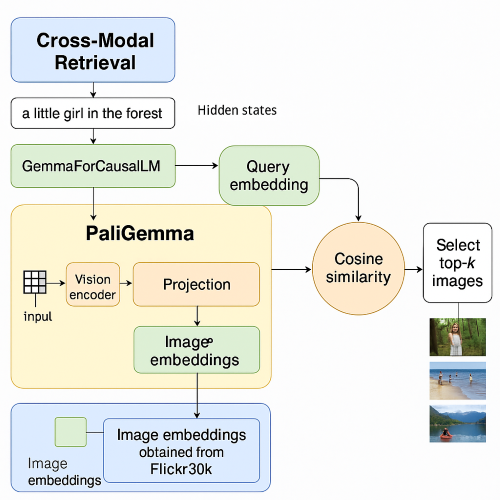

In [14]:
from sklearn.cluster import MiniBatchKMeans
from sklearn.preprocessing import normalize
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.utils import resample
from sklearn.decomposition import PCA
from umap import UMAP
from collections import defaultdict
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd

In [15]:
# Convert to numpy and move to cpu if still in gpu, then normalize
img_embs_np = normalize(img_embs.cpu().numpy())
txt_embs_np = normalize(txt_embs.cpu().numpy())

In [16]:
def retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np, top_k=10, batch_size=1, device='cuda'):
    """
    Retrieve the top-k most similar images for a given text query in a zero-shot setting.
    """
    # Get text embeddings for the query text from our model
    text_embs = get_text_embeddings(model, tokenizer, [query_text], batch_size=batch_size, device=device)
    
    # Convert to numpy and normalize the query text
    text_embs_np = normalize(text_embs.cpu().numpy(), axis=1)
    
    # Get the 1-D vector (1, 2048) -> (2048,)
    query_vec = text_embs_np[0]
    
    # Compute top image indices and similarity scores
    sims = img_embs_np @ query_vec
    top_indices = np.argsort(-sims)[:top_k]
    scores = sims[top_indices]   
    return top_indices, scores

In [17]:
def show_top_images(images, top_img_indices, display_top_1=False, scores=None, n_rows=2):
    if display_top_1:
        idx = top_img_indices[0]  # rank 1 image
        plt.figure(figsize=(5, 5))
        plt.imshow(images[idx])
        plt.axis('off')   
        title = "Rank 1"
        if scores is not None:
            title += f"\nScore: {scores[0]:.3f}"
        plt.title(title)
        plt.show()
    else:
        top_k = len(top_img_indices)
        n_cols = math.ceil(top_k / n_rows)
        
        plt.figure(figsize=(4 * n_cols, 4 * n_rows))
        for i, idx in enumerate(top_img_indices):
            plt.subplot(n_rows, n_cols, i + 1)
            plt.imshow(images[idx])
            plt.axis('off')
            title = f"Rank {i + 1}"
            if scores is not None:
                title += f"\nScore: {scores[i]:.3f}"
            plt.title(title)
        plt.tight_layout()
        plt.show()

#### Cross-Modal Retrieval - Visual Evaluation
This serves as a simple visual evaluation of the model’s ability to align text and image representations.

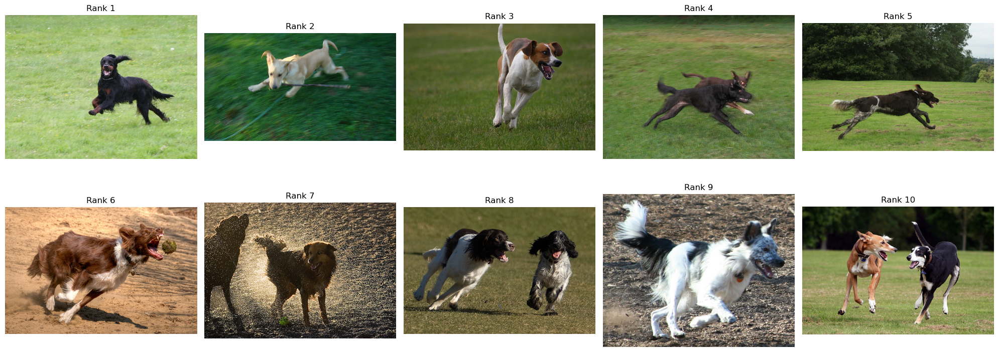

In [84]:
query_text = "A dog playing in the park"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
show_top_images(images, top_img_indices)

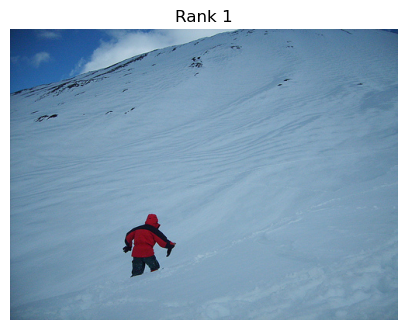

In [110]:
query_text = "A man climbing snowy mountain"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
show_top_images(images, top_img_indices, display_top_1=True)

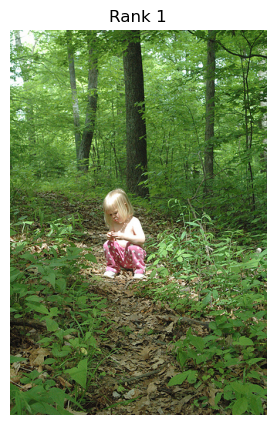

In [130]:
query_text = "A little girl in the forest"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
show_top_images(images, top_img_indices, display_top_1=True)

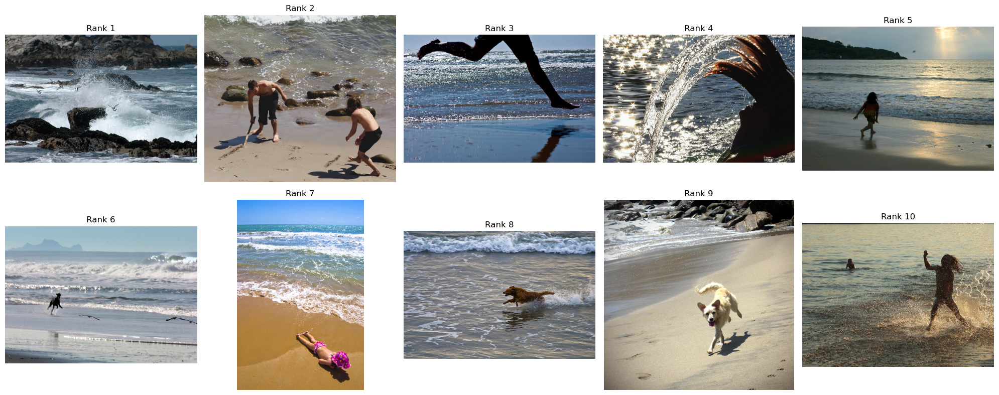

In [31]:
query_text = "Beach scene"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
show_top_images(images, top_img_indices)

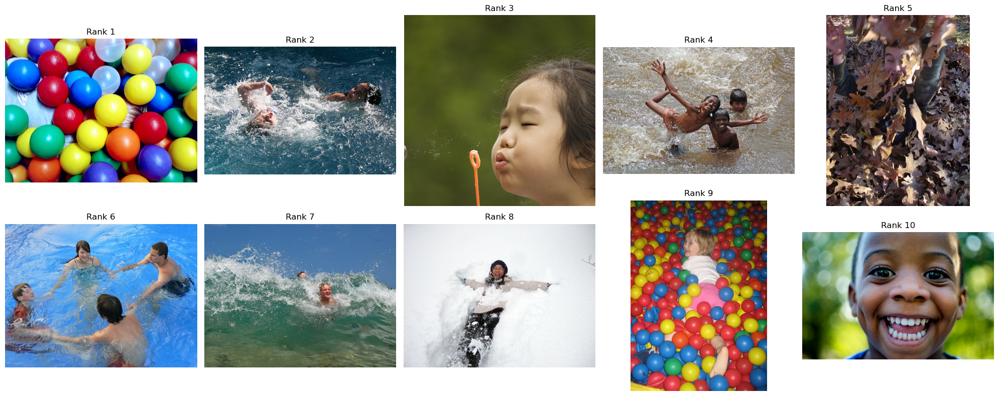

In [37]:
query_text = "Happy faces"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
show_top_images(images, top_img_indices)

#### Limitations in Retrieval Precision
For the query prompt "Dancing competition", the model retrieved only 2 correct images out of 10, based on visual evaluation.

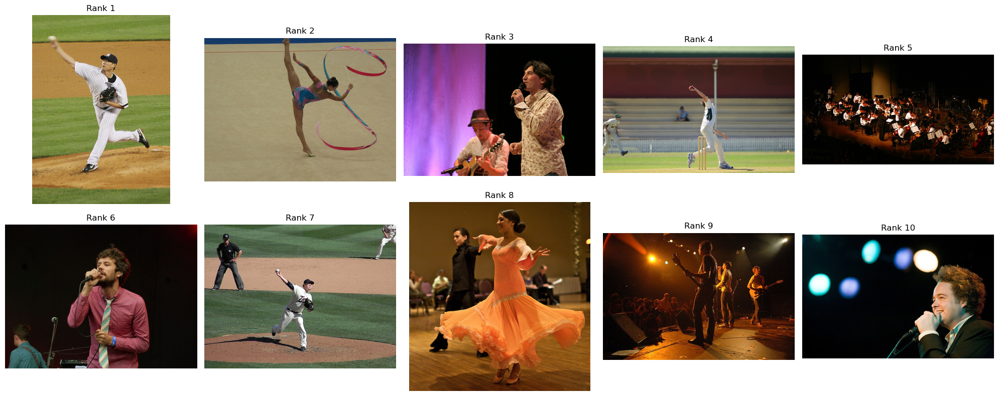

In [34]:
query_text = "Dancing competition"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
show_top_images(images, top_img_indices)

### Cross-Modal Retrieval - Metric Evaluation

In [42]:
def evaluate_retrieved_set(retrieved_embs, prompt, plot=True):   
    # Pairwise cosine similarities
    sims = retrieved_embs @ retrieved_embs.T
    triu_indices = np.triu_indices_from(sims, k=1)  # upper triangle, exclude diagonal
    pairwise_sims = sims[triu_indices]   
    results = {
        'Cohesion': pairwise_sims.mean(),
        'MaxSim': pairwise_sims.max(),
        'MinSim': pairwise_sims.min(),
        'StdSim': pairwise_sims.std(),
    }    
    if plot:
        plt.figure(figsize=(7,5))
        plt.hist(pairwise_sims, bins=20, alpha=0.7, color='steelblue', edgecolor='white')
        plt.axvline(results['Cohesion'], color='red', linestyle='--', label=f"Mean = {results['Cohesion']:.3f}")
        plt.xlabel('Cosine Similarity')
        plt.ylabel('Count')
        plt.title(f'Distribution of Pairwise Similarities: ("{prompt}")')
        plt.grid(axis='y', linestyle='--', alpha=0.6)
        plt.legend()
        plt.show()    
    print(results)

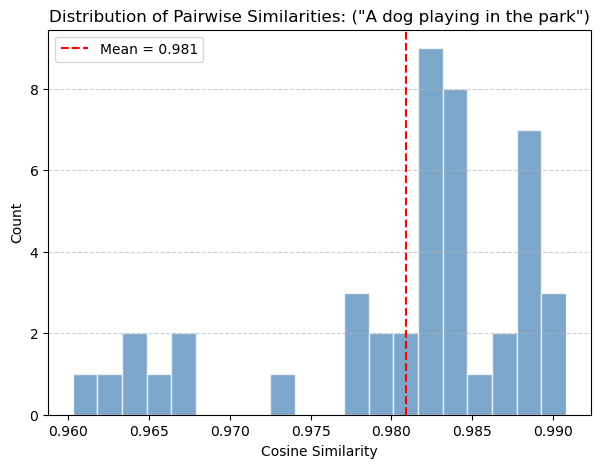

{'Cohesion': 0.9809216, 'MaxSim': 0.9908124, 'MinSim': 0.9602726, 'StdSim': 0.008031793}


In [43]:
query_text = "A dog playing in the park"
top_img_indices, scores = retrieve_top_images_from_text(query_text, model, tokenizer, img_embs_np)
evaluate_retrieved_set(img_embs_np[top_img_indices], query_text)

### Clustering and Silhouette-Based Selection of K
The silhouette score is particularly expensive because it computes pairwise distances between all points. To speed up we compute silhouette score on a subset of points.

In [70]:
sample_size = 5000
img_embs_sample = resample(img_embs_np, n_samples=sample_size, random_state=42)

K = [10, 20, 30, 40, 50, 60]
inertias = []
sil_scores = []

for k in K:
    kmeans = MiniBatchKMeans(n_clusters=k, random_state=42, batch_size=1024, n_init=10)
    labels = kmeans.fit_predict(img_embs_np)  # fit on full data
    inertias.append(kmeans.inertia_)

    # Silhouette only on a sample
    sample_labels = labels[np.random.choice(len(labels), size=sample_size, replace=False)]
    score = silhouette_score(img_embs_sample, sample_labels)
    sil_scores.append(score)

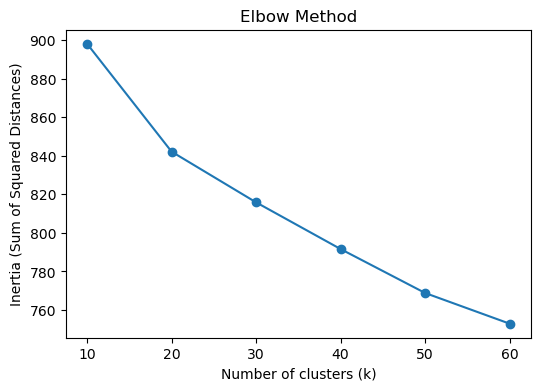

In [53]:
# Plot inertia vs k
plt.figure(figsize=(6, 4))
plt.plot(K, inertias, marker='o')
plt.xlabel("Number of clusters (k)")
plt.ylabel("Inertia (Sum of Squared Distances)")
plt.title("Elbow Method");

* The biggest drop in inertia happens between 10 → 20 clusters.

Based on this, **20 clusters** is a solid starting point.

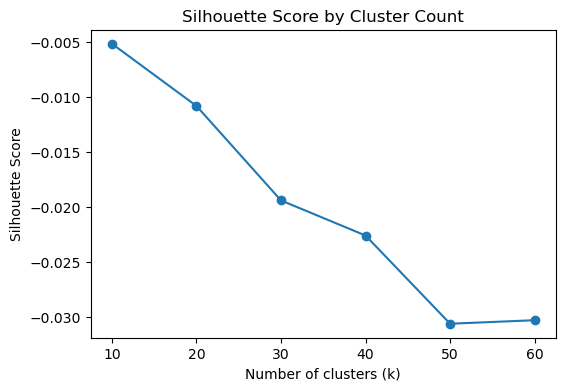

In [71]:
# Plot silhouette score vs k
plt.figure(figsize=(6, 4))
plt.plot(K, sil_scores, marker='o')
plt.xlabel("Number of clusters (k)")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score by Cluster Count");

### Low Silhouette Scores
The silhouette scores are consistently low and show little variation across different values of k. This suggests a few things:
* The 2048-dimensional embeddings likely don’t form well-separated clusters, at least not with standard KMeans.
* There’s no clear optimal k, as the scores don’t peak.
* The low scores may result from the high dimensionality and the diversity of the Flickr30K dataset, which lacks obvious natural groupings.

**Next step:** Apply **PCA** to reduce dimensionality before clustering. This can help:
* Improve cluster separability
* Increase silhouette scores
* Reduce noise and computation time for KMeans

### Dimensionality Reduction with PCA
PCA reduces high-dimensional data by finding new axes (principal components) that capture the most variance. It works by:
1. Centering the data (zero mean).
2. Computing the covariance matrix to understand feature relationships.
3. Performing eigen decomposition to identify principal components ranked by explained variance.
4. Selecting the top 50 components that retain most of the data’s information.
5. Projecting the original 2048-D data onto these 50 components, creating a compact representation.

This process reduces noise, highlights meaningful patterns, and speeds up clustering while preserving the essential structure of the data.

In [12]:
pca_components = 50
pca = PCA(n_components=pca_components, random_state=42)
img_embs_reduced = pca.fit_transform(img_embs_np)

print(f"Original shape: {img_embs_np.shape}, Reduced shape: {img_embs_reduced.shape}")

Original shape: (31014, 2048), Reduced shape: (31014, 50)


### Clustering with MiniBatchKMeans

In [13]:
# MiniBatchKMeans for img_embs_reduced - Based on elbow/silhouette or experiment we chose num_clusters to be 20
num_clusters = 20
batch_size = 1024

kmeans = MiniBatchKMeans(
    n_clusters=num_clusters,
    batch_size=batch_size,
    random_state=42,
    n_init=10
)
img_labels = kmeans.fit_predict(img_embs_reduced)
dbi = davies_bouldin_score(img_embs_reduced, img_labels)
print(f'Image Cluster labels shape: {img_labels.shape}')
print(f'Cluster centers shape (PCA space): {kmeans.cluster_centers_.shape}')
print(f'Davies Bouldin Score: {dbi}')

Image Cluster labels shape: (31014,)
Cluster centers shape (PCA space): (20, 50)
Davies Bouldin Score: 2.9178229128084903


In [14]:
# Text embeddings PCA
pca_components_txt = 50   # tuned the same as images
pca_txt = PCA(n_components=pca_components_txt, random_state=42)
txt_embs_reduced = pca_txt.fit_transform(txt_embs_np)

print(f"Original text shape: {txt_embs_np.shape}, Reduced shape: {txt_embs_reduced.shape}")

# MiniBatchKMeans for txt_embs_reduced
num_txt_clusters = 20
batch_size = 1024

kmeans_txt = MiniBatchKMeans(
    n_clusters=num_txt_clusters,
    batch_size=batch_size,
    random_state=42,
    n_init=10
)
txt_labels = kmeans_txt.fit_predict(txt_embs_reduced)
dbi_text = davies_bouldin_score(txt_embs_reduced, txt_labels)
print(f'Text cluster labels shape: {txt_labels.shape}')
print(f'Davies Bouldin Score: {dbi_text}')

Original text shape: (31014, 2048), Reduced shape: (31014, 50)
Text cluster labels shape: (31014,)
Davies Bouldin Score: 3.242537639480627


### Clustering with DBSCAN

In [29]:
from sklearn.cluster import DBSCAN

def run_dbscan_on_embeddings(embeddings, eps=0.2, min_samples=30):
    labels = DBSCAN(eps=eps, min_samples=min_samples, metric='cosine', n_jobs=-1).fit_predict(embeddings)
    return labels

In [30]:
labels_img = run_dbscan_on_embeddings(img_embs_reduced)
dbi = davies_bouldin_score(img_embs_reduced, labels_img)
print(f'Davies Bouldin Score with DBSCAN: {dbi}')

Davies Bouldin Score with DBSCAN: 1.868687546695359


We achieved a lower Davies–Bouldin score with DBSCAN compared to Mini-Batch KMeans. The Davies–Bouldin index ranges from 0 to infinity, where lower values indicate better clustering quality. A lower score reflects clusters that are more compact (data points are closer together within a cluster) and more distinct (further separated from other clusters).

In [31]:
def plot_clusters_3d_umap(embeddings, labels, title):
    # Reduce to 3D with UMAP
    umap = UMAP(n_components=3, n_neighbors=20)
    reduced = umap.fit_transform(embeddings)

    fig = plt.figure(figsize=(6, 5))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(reduced[:, 0], reduced[:, 1], reduced[:, 2], c=labels, cmap='tab10', s=15)
    cbar = fig.colorbar(scatter, ax=ax, pad=0.1)
    cbar.set_label('Cluster ID')
    ax.set_title(title)
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')
    ax.set_zlabel('UMAP 3')
    plt.tight_layout()
    plt.show()

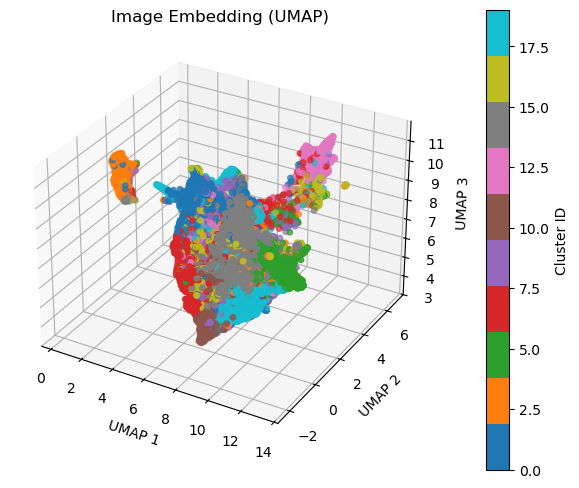

In [37]:
plot_clusters_3d_umap(img_embs_reduced, img_labels, "Image Embedding (UMAP)")

#### UMAP Interpretation
This 3D UMAP plot visualizes high-dimensional image embeddings (initially of shape (31014, 2048), reduced to (31014, 50) via PCA, then mapped to 3D using UMAP with n_neighbors=20).
* Each point is an image embedding from the Flickr30k dataset.
* The colors represent cluster assignments or label groupings from batch K-Means.
* The 3D coordinates are UMAP components (UMAP 1, UMAP 2, UMAP 3): lower-dimensional representations preserving local structure in the original embedding space.

**Dense Core Cluster:**
* The majority of points form a dense central cloud, suggesting most image embeddings lie in a continuous semantic space with subtle variation.
* This is common for natural image datasets like Flickr30k where scenes often share compositional elements.

**Isolated Cluster on the Left:**
* The group of orange and yellow dots on the left is well-separated.
* This could represent a distinct semantic cluster, such as highly stylized or outlier image types

**Vertical Spread (UMAP 3):**
* Some vertical structure is present, but less defined than in UMAP 1 or 2.
* It may encode weaker variation (UMAP sometimes flattens clusters in higher dimensions).

These clusters reveal that PaliGemma's vision encoder captures some semantically meaningful features, but not fully separable visual-textual associations.

In [35]:
from textwrap import wrap

def show_cluster_grid(img_cluster_id, txt_cluster_id, num_examples=12, cols=4):
    # Find all caption indices that match this cluster pair
    matching_captions = [
        i for i, c_lbl in enumerate(txt_labels)
        if c_lbl == txt_cluster_id and img_labels[caption_to_image[i]] == img_cluster_id
    ]    
    if not matching_captions:
        print(f"No examples found for img_cluster_{img_cluster_id} + txt_cluster_{txt_cluster_id}")
        return
    selected = matching_captions[:num_examples]   
    rows = (len(selected) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    axes = axes.flatten()    
    for ax_idx, (ax, c_idx) in enumerate(zip(axes, selected)):
        img_idx = caption_to_image[c_idx]
        img = images[img_idx]
        cap = captions[c_idx]
        ax.imshow(img)
        ax.axis("off")
        
        # Wrap caption text to fit
        wrapped_cap = "\n".join(wrap(cap, width=40))
        ax.set_title(wrapped_cap, fontsize=8)

    # Hide any unused subplots if we have fewer than rows*cols
    for ax in axes[len(selected):]:
        ax.axis("off")   
    plt.suptitle(f"Examples for Image Cluster {img_cluster_id} & Text Cluster {txt_cluster_id}", fontsize=14)
    plt.tight_layout()
    plt.show()

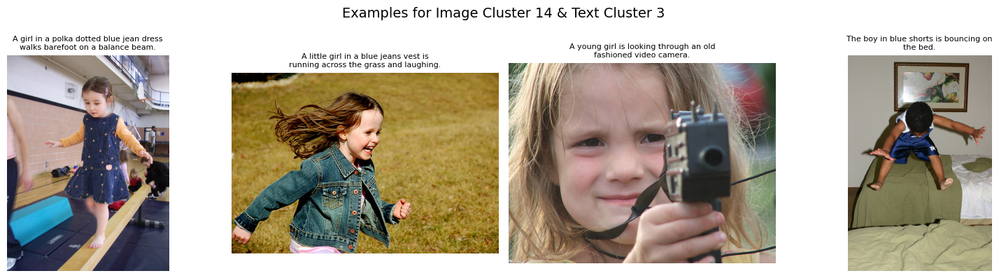

In [51]:
show_cluster_grid(img_cluster_id=14, txt_cluster_id=3, num_examples=4, cols=4)

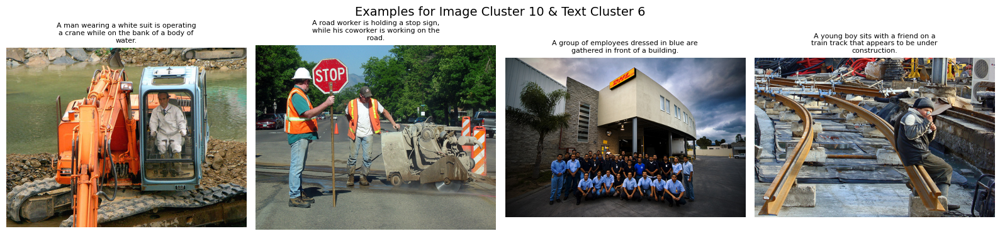

In [52]:
show_cluster_grid(img_cluster_id=10, txt_cluster_id=6, num_examples=4, cols=4)

#### Conclusion on Clusters
After clustering and visualizing the images and captions within each cluster, we observed that, for example, one cluster predominantly grouped images and captions depicting children engaged in activities (e.g., a girl walking on a balance beam, a girl running, a boy bouncing on a bed). Another cluster included examples related to construction work, such as workers on the road, a man operating a crane, and a boy on a train track that appears to be under construction. Interestingly, that same cluster also contained scenes of employees in blue uniforms gathered outside a building, which—while not directly related to construction—shares visual or contextual features (e.g., uniforms, group work, industrial setting) that may have influenced their proximity in the embedding space.

These findings suggest that the learned embeddings capture high-level semantic themes and exhibit cross-modal consistency, although some cluster boundaries may be influenced by visual or contextual similarities that span multiple concepts.

###  Contingency Table (Cross-Tabulation) - Heat Map

In [15]:
# Which captions belong to which clusters
caption_cluster_map = {idx: txt_labels[idx] for idx in range(len(txt_labels))}

# Which images belong to which clusters
image_cluster_map = {idx: img_labels[idx] for idx in range(len(img_labels))}

# Combine them: for each caption, find its paired image cluster
pairs = []
for cap_idx, txt_cluster in caption_cluster_map.items():
    img_idx = caption_to_image[cap_idx]  # Which image this caption belongs to
    img_cluster = image_cluster_map[img_idx]
    pairs.append((img_cluster, txt_cluster))

In [16]:
# Group images by their cluster
images_by_cluster = defaultdict(list)
for img_idx, cluster_id in image_cluster_map.items():
    images_by_cluster[cluster_id].append(img_idx)

# Group captions by their cluster
captions_by_cluster = defaultdict(list)
for cap_idx, cluster_id in caption_cluster_map.items():
    captions_by_cluster[cluster_id].append(cap_idx)

In [17]:
# Build DataFrame of pairs
df_pairs = pd.DataFrame(pairs, columns=['image_cluster', 'caption_cluster'])

# Cross-tabulate
contingency = pd.crosstab(df_pairs['image_cluster'], df_pairs['caption_cluster'])

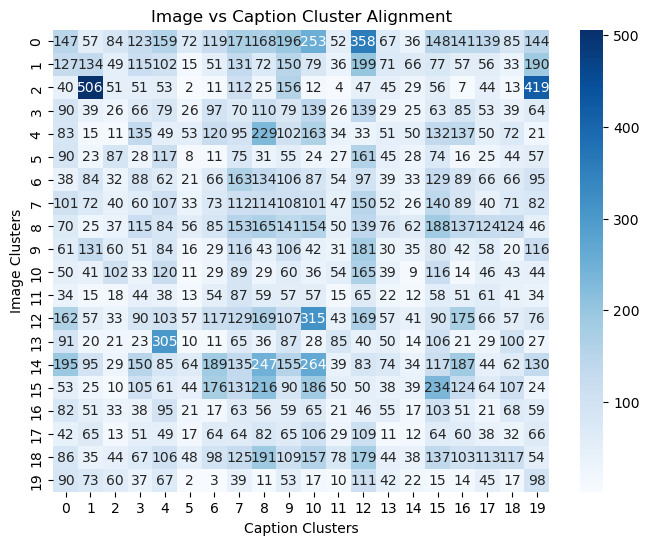

In [22]:
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.heatmap(contingency, cmap='Blues', annot=True, fmt='d')
plt.title('Image vs Caption Cluster Alignment')
plt.xlabel('Caption Clusters')
plt.ylabel('Image Clusters')
plt.show()

1. High Alignment Pairs
Cells with higher values (especially those in darker shades of blue) suggest a strong alignment between that image and caption cluster.
   * Image Cluster 2 and Caption Cluster 0: 506
   * Image Cluster 2 and Caption Cluster 19: 419
   * Image Cluster 12 and Caption Cluster 10: 315 <br></br>

2. Diagonal Trends
If alignment was perfect between images and captions (e.g., if cluster 0 images always matched with cluster 0 captions), we'd expect a strong diagonal pattern. Here, the alignment is not strictly diagonal, which suggests that the caption and image clusterings are not perfectly aligned — they might be based on different features or modalities.

3. Cluster Behavior
   * Some image clusters like 2 and 13 show strong preferences for particular caption clusters.
   * Some image clusters (e.g., 6, 10, 11, 17) show more distributed associations, suggesting their image content may be more generic or their captions more varied.

### Discovering Image-Text Cluster Associations Using Association Rule Mining
This section outlines a multi-step process to uncover meaningful relationships between image and text clusters using association rule mining.

1. Transaction Construction: Each caption is paired with its corresponding image to create a "transaction" — a set containing one image cluster and one text cluster. This transforms raw clustering results into a structured format suitable for mining.

2. One-Hot Encoding: The transactions are converted into a binary (one-hot encoded) DataFrame, representing the presence or absence of each cluster label in each transaction.

3. Frequent Itemset Mining: The Apriori algorithm is applied to identify frequently co-occurring cluster pairs (image-text combinations) that appear in at least 1% of all transactions.

4. Association Rule Generation: From the frequent itemsets, the code derives association rules — specifically seeking those with a lift greater than or equal to 1. These rules help reveal which text clusters tend to co-occur with specific image clusters more often than would be expected by chance.

In [56]:
from mlxtend.frequent_patterns import apriori, association_rules

In [57]:
# 1. Build the transactions
transactions = []
for caption_idx, txt_cluster in enumerate(txt_labels):
    img_idx = caption_to_image[caption_idx]  # Which image this caption is tied to
    img_cluster = img_labels[img_idx]
    # Each transaction is a set of one image cluster + one text cluster
    transactions.append({f"img_cluster_{img_cluster}", f"txt_cluster_{txt_cluster}"})

print(f"Built {len(transactions)} transactions (one per caption).")

# 2. Convert transactions into a one-hot encoded DataFrame
all_items = sorted({item for t in transactions for item in t})
df = pd.DataFrame([{item: (item in t) for item in all_items} for t in transactions])

# 3. Run Apriori to find frequent itemsets
min_support = 0.01  # tweak this based on dataset size
frequent_itemsets = apriori(df, min_support=min_support, use_colnames=True)

# 4. Generate association rules
rules = association_rules(frequent_itemsets, metric="lift", min_threshold=1.0)
rules = rules.sort_values(by="lift", ascending=False)

Built 31014 transactions (one per caption).


In [58]:
# association rules
rules.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,representativity,leverage,conviction,zhangs_metric,jaccard,certainty,kulczynski
4,(txt_cluster_1),(img_cluster_2),0.050397,0.054266,0.016315,0.323736,5.965752,1.0,0.013580,1.398470,0.876552,0.184672,0.284933,0.312195
5,(img_cluster_2),(txt_cluster_1),0.054266,0.050397,0.016315,0.300654,5.965752,1.0,0.013580,1.357844,0.880138,0.184672,0.263538,0.312195
6,(img_cluster_2),(txt_cluster_19),0.054266,0.059522,0.013510,0.248960,4.182693,1.0,0.010280,1.252235,0.804581,0.134727,0.201428,0.237969
7,(txt_cluster_19),(img_cluster_2),0.059522,0.054266,0.013510,0.226977,4.182693,1.0,0.010280,1.223423,0.809077,0.134727,0.182622,0.237969
2,(txt_cluster_10),(img_cluster_12),0.073676,0.068131,0.010157,0.137856,2.023404,1.0,0.005137,1.080874,0.546012,0.077149,0.074823,0.143466


| Column            | Meaning                                                                                                    |
| ----------------- | ---------------------------------------------------------------------------------------------------------- |
| **antecedents**   | The “if” part — cluster(s) on the left side of the rule                                                    |
| **consequents**   | The “then” part — cluster(s) on the right side of the rule                                                 |
| **support**       | How often the combined itemset appears in your data (fraction)                                             |
| **confidence**    | Probability that the consequent occurs when antecedent does                                                |
| **lift**          | How much more likely the consequent occurs with antecedent vs independent ( >1 means positive association) |
| **other metrics** | Variants measuring strength or interestingness of the rule                                                 |


In [54]:
def show_top_rules_examples(rules, top_n=5, num_examples=12, cols=4, sort_by="lift"):
    rules_sorted = rules.sort_values(by=sort_by, ascending=False).head(top_n)   
    for idx, row in rules_sorted.iterrows():
        antecedents = list(row["antecedents"])
        consequents = list(row["consequents"])
        
        # Extract cluster IDs
        img_clusters = [int(x.split("_")[-1]) for x in antecedents + consequents if x.startswith("img_cluster")]
        txt_clusters = [int(x.split("_")[-1]) for x in antecedents + consequents if x.startswith("txt_cluster")]        
        if len(img_clusters) != 1 or len(txt_clusters) != 1:
            continue
        img_cluster_id, txt_cluster_id = img_clusters[0], txt_clusters[0]
        matching_captions = [
            i for i, c_lbl in enumerate(txt_labels)
            if c_lbl == txt_cluster_id and img_labels[caption_to_image[i]] == img_cluster_id
        ]       
        if not matching_captions:
            continue  # Skip if no matching samples
        selected = matching_captions[:num_examples]
        rows = (len(selected) + cols - 1) // cols
        fig, axes = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
        axes = axes.flatten()        
        for ax, c_idx in zip(axes, selected):
            img_idx = caption_to_image[c_idx]
            img = images[img_idx]
            cap = captions[c_idx]
            ax.imshow(img)
            ax.axis("off")
            wrapped_cap = "\n".join(wrap(cap, width=40))
            ax.set_title(wrapped_cap, fontsize=8)            
        for ax in axes[len(selected):]:
            ax.axis("off")      
        plt.suptitle(
            f"Rule {idx+1} (Lift: {row['lift']:.2f}, Confidence: {row['confidence']:.2f})\n"
            f"img_cluster_{img_cluster_id} ↔ txt_cluster_{txt_cluster_id}",
            fontsize=14
        )
        plt.tight_layout()
        plt.show()

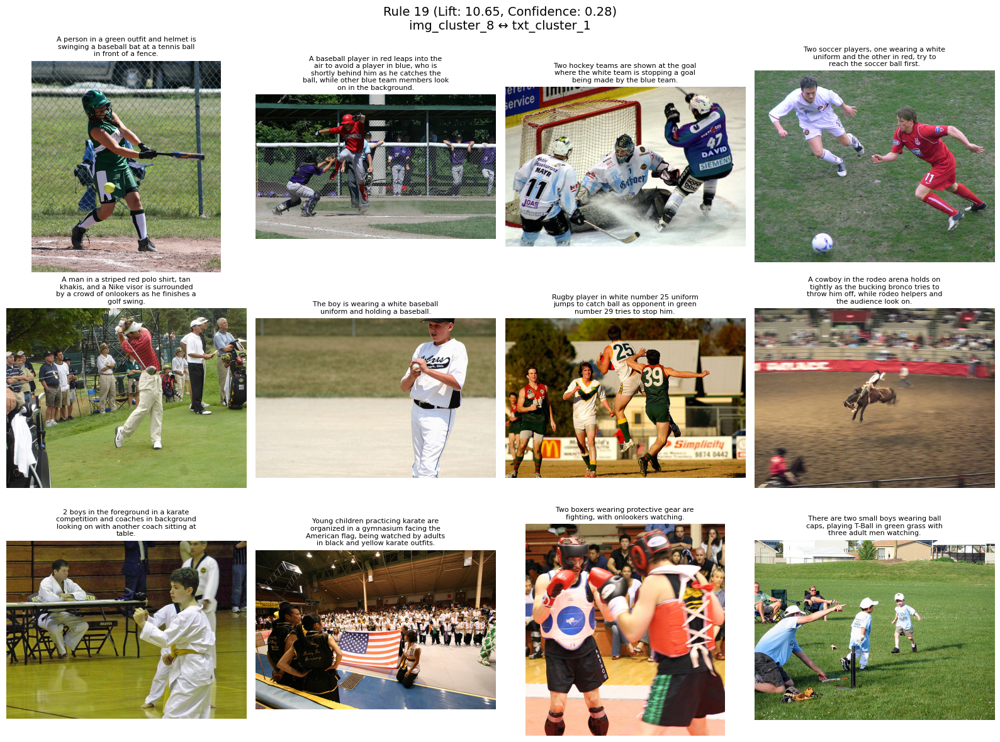

In [122]:
# Show top rules, sorted by lift
show_top_rules_examples(rules, top_n=1, num_examples=12, cols=4, sort_by="lift")

### Findings
The association rule mining uncovered compelling relationships between specific image and text clusters. Strong image-text associations rule by lift (top 1) reveals sport, activity-based patterns:
* Using show_top_rules_examples(rules, top_n=1, num_examples=12, cols=4, sort_by="lift"), the strongest rule indicates that images of people participating in a wide range of sports (e.g., running, cycling, playing ball games) are highly associated with certain text clusters. This high-lift rule reflects a strong semantic link between visual depictions of sports and their textual descriptions, validating the alignment between image features and caption content.

These findings demonstrate that the discovered clusters and association rules meaningfully capture semantic themes, such as physical activity, play, and sports, across both visual and textual modalities.

### Anomaly Detection

In [20]:
from sklearn.ensemble import IsolationForest
from math import ceil

In [58]:
# Combine (simple concatenation)
combined_embs = np.hstack([img_embs_reduced, txt_embs_reduced])

# Run Isolation Forest
iso = IsolationForest(contamination=0.01, random_state=42)  # 1% anomalies, tune this
scores = iso.fit_predict(combined_embs)
anomaly_scores = iso.decision_function(combined_embs)       # lower = more anomalous

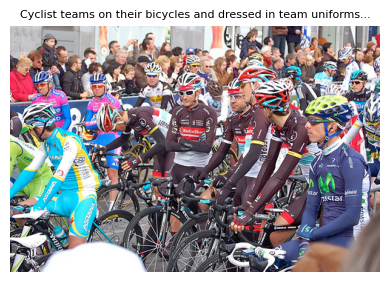

In [59]:
anomaly_indices = np.argsort(anomaly_scores)[:1]
fig, ax = plt.subplots(figsize=(4, 4))
idx = anomaly_indices[0]
img = images[caption_to_image[idx]]
caption = captions[idx]
ax.imshow(img)
ax.set_title(caption[:60] + "..." if len(caption) > 60 else caption, fontsize=8)
ax.axis("off")
plt.tight_layout();

#### What Isolation Forest Does
We creates a joint embedding space of shape (31014, 100) by stacking horizontally the reduced dimensions of both image and text embeddings. If image and caption are well-aligned semantically, their embeddings will be "coherent" in this joint space. Isolation Forest then:
* Builds random decision trees:
   * For each tree, it randomly selects features and split values to recursively partition the data.
   * Points that get isolated quickly are likely outliers.
* Calculates anomaly score for each point:
   * The decision_function gives a score where lower = more anomalous.
   * fit_predict() assigns -1 for anomalies, 1 for normal points.
* Uses contamination=0.01 to label the top 1% most "isolatable" points as anomalies.

#### Why this image might be an anomaly
* The image is visually dense: many people, colorful uniforms, bikes, crowd background.
* This might contrast with simpler or more centered subjects in other dataset images.

## Conclusion
This project explores the use of the PaliGemma vision-language model for cross-modal retrieval, clustering, and anomaly detection on the Flickr30k dataset. By leveraging pretrained multimodal embeddings, we evaluated the model's ability to align natural language prompts with relevant images and uncovered semantic structures in the embedding space. 

Cross-modal retrieval experiments revealed variable alignment performance. Qualitative inspection indicated that the proportion of correct matches among the top-10 retrieved results ranged from 20% to 100%, depending on the query. For example, the prompt 'A dog playing in the park' yielded 10/10 correct matches, while 'A dancing competition' produced only 2/10. Visualization with UMAP revealed overlapping clusters with some denser semantic regions, suggesting that PaliGemma's embeddings capture partial but not fully separable visual-textual associations.

Clustering with DBSCAN achieved lower Davies-Bouldin scores than MiniBatch K-Means, indicating more compact and distinct clusters, and highlighting the advantage of density-based methods for irregular embedding distributions. Association rule mining further revealed strong cross-modal relationships, such as between images of sports activities and their textual descriptions. Finally, anomaly detection with Isolation Forest identified visually complex or semantically ambiguous samples, demonstrating the utility of joint embedding analysis for outlier detection.

Overall, these results suggest that PaliGemma effectively captures high-level semantic themes across modalities. The use of DBSCAN and association rule mining provides deeper insights into the structure of multimodal embeddings, while anomaly detection opens the door to identifying challenging or misaligned examples. Although preliminary, this work lays a solid foundation for studying semantic alignment in joint image-text representations and motivates future exploration of more diverse datasets and tasks.

#### Future Work
While the current work focuses on evaluating pretrained embeddings and unsupervised analysis, future extensions could explore domain-specific fine-tuning. For example, adapting PaliGemma to the medical domain would allow retrieval of images for similar clinical cases or support Visual Question Answering (VQA) on radiology reports and medical imagery. Such fine-tuning would not only enhance retrieval accuracy but also demonstrate the model’s applicability in high-stakes, real-world scenarios where multimodal alignment is critical.

### References

1. Google Research and DeepMind. *PaliGemma: A versatile 3B VLM for transfer*. arXiv preprint arXiv:2407.07726, 2024. [Link](https://arxiv.org/pdf/2407.07726)

2. Google AI Developers. *PaliGemma*. Google AI documentation, February 19, 2025. [Link](https://ai.google.dev/gemma/docs/paligemma)

3. Google Research. *PaliGemma model implementation (paligemma.py) in Big Vision*. GitHub repository, 2025. [Link](https://github.com/google-research/big_vision/blob/main/big_vision/models/proj/paligemma/paligemma.py)

4. Hugging Face. *PaliGemma – Google's Cutting-Edge Open Vision Language Model*. Hugging Face Blog, May 14, 2024. [Link](https://huggingface.co/blog/paligemma)

5. Umar Jamil. *pytorch-paligemma*. GitHub, July 2024. [Link](https://github.com/hkproj/pytorch-paligemma)

6. Lihi Gur Arie. *Building an Image Similarity Search Engine with FAISS and CLIP*. Medium, August 23, 2024. [Link](https://medium.com/data-science/building-an-image-similarity-search-engine-with-faiss-and-clip-2211126d08fa)
